In [ ]:
!pip install netCDF4 xarray numpy pandas matplotlib cartopy scikit-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 91.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 96.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 50.9 MB/s eta 0:00:00


In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import glob
import os
import re
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from google.colab import drive
from sklearn.cluster import MiniBatchKMeans
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MiniBatchKMeans
import gc
import warnings
warnings.filterwarnings('ignore')

# Configuración de carpetas
chl_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527"
flh_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_FLH_2022.0-20251004_024829"
par_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_PAR_2022.0-20251004_025127"

# Configuración de parámetros
target_months = list(range(1, 13))  # Todos los meses
target_years = list(range(2003, 2026))  # Todos los años
spatial_frac = 0.2
n_clusters = 7
max_points_per_month = 50000  # LÍMITE MÁXIMO de puntos por mes

def optimized_load_from_folder(folder, var_name, month, year, spatial_frac=0.5):
    """
    Versión optimizada para carga de datos con límites de memoria
    """
    datasets = []
    files_processed = 0

    for f in os.listdir(folder):
        if not f.endswith(".nc"):
            continue

        try:
            date_str = f.split(".")[1]
            y = int(date_str[:4])
            m = int(date_str[4:6])
            if y != year or m != month:
                continue
        except:
            continue

        path = os.path.join(folder, f)
        try:
            # Usar chunks para no cargar todo en memoria
            ds = xr.open_dataset(path, chunks={'lat': 100, 'lon': 100})

            if var_name in ds:
                lat = ds["lat"].values
                lon = ds["lon"].values

                if len(lat) > 5 and len(lon) > 5:
                    # Muestreo más agresivo
                    n_lat = max(1, int(len(lat) * spatial_frac))
                    n_lon = max(1, int(len(lon) * spatial_frac))

                    lat_idx = np.sort(np.random.choice(len(lat), n_lat, replace=False))
                    lon_idx = np.sort(np.random.choice(len(lon), n_lon, replace=False))

                    # Cargar solo los datos necesarios
                    sub_ds = ds[[var_name]].isel(lat=lat_idx, lon=lon_idx).load()
                    datasets.append(sub_ds)
                    files_processed += 1

                    # Limitar número de archivos por mes para evitar memoria
                    if files_processed >= 3:  # Máximo 3 archivos por variable por mes
                        ds.close()
                        break

            ds.close()

        except Exception as e:
            print(f"Error abriendo {f}: {e}")
            continue

    return datasets

def load_and_combine_monthly_data_optimized(month, year, spatial_frac=0.5):
    """
    Versión optimizada para carga mensual
    """
    print(f"📥 Cargando datos para {year}-{month:02d}...")

    # Cargar datos con límites
    chl_datasets = optimized_load_from_folder(chl_folder, "chlor_a", month, year, spatial_frac)
    flh_datasets = optimized_load_from_folder(flh_folder, "nflh", month, year, spatial_frac)
    par_datasets = optimized_load_from_folder(par_folder, "par", month, year, spatial_frac)

    if not chl_datasets or not flh_datasets or not par_datasets:
        print(f"❌ No hay datos suficientes para {year}-{month:02d}")
        return None

    try:
        # Combinar con manejo de memoria
        chl_combined = xr.concat(chl_datasets, dim="time")
        flh_combined = xr.concat(flh_datasets, dim="time")
        par_combined = xr.concat(par_datasets, dim="time")

        # Liberar datasets individuales
        del chl_datasets, flh_datasets, par_datasets
        gc.collect()

        # Renombrar y combinar
        chl_combined = chl_combined.rename({'chlor_a': 'chl'})
        flh_combined = flh_combined.rename({'nflh': 'flh'})
        par_combined = par_combined.rename({'par': 'par'})

        merged = xr.merge([chl_combined, flh_combined, par_combined], compat='override')

        print(f"✅ Datos combinados: {merged.dims}")
        return merged

    except Exception as e:
        print(f"❌ Error combinando datos: {e}")
        return None

def process_data_for_clustering_optimized(merged_ds, max_points=50000):
    """
    Versión CORREGIDA del procesamiento que asegura dimensiones consistentes
    """
    if merged_ds is None:
        return None, None, None

    try:
        # Stack dimensiones
        stacked = merged_ds.stack(points=("lat", "lon", "time"))

        # Filtrar puntos válidos en LAS TRES variables simultáneamente
        valid_mask = (~xr.ufuncs.isnan(stacked["chl"])) & \
                    (~xr.ufuncs.isnan(stacked["flh"])) & \
                    (~xr.ufuncs.isnan(stacked["par"]))

        # Aplicar máscara para mantener solo puntos válidos
        stacked_valid = stacked.where(valid_mask, drop=True)

        if len(stacked_valid.points) == 0:
            print("❌ No hay puntos válidos después del filtrado")
            return None, None, None

        # LIMITAR número de puntos para evitar memoria
        n_points = len(stacked_valid.points)
        if n_points > max_points:
            print(f"⚠️  Muchos puntos ({n_points}), muestreando a {max_points}")
            # Muestrear puntos aleatorios
            idx = np.random.choice(n_points, max_points, replace=False)
            stacked_valid = stacked_valid.isel(points=idx)

        # Extraer datos - ESTA ES LA PARTE CRÍTICA CORREGIDA
        variables = ["chl", "flh", "par"]

        # Extraer todas las variables y coordenadas del MISMO stacked_valid
        chl_values = stacked_valid["chl"].values
        flh_values = stacked_valid["flh"].values
        par_values = stacked_valid["par"].values
        lat_values = stacked_valid["lat"].values
        lon_values = stacked_valid["lon"].values

        # Verificar que todos tengan la misma longitud
        lengths = [len(chl_values), len(flh_values), len(par_values), len(lat_values), len(lon_values)]
        if len(set(lengths)) != 1:
            print(f"❌ Error: Dimensiones inconsistentes {lengths}")
            # Forzar dimensiones iguales tomando el mínimo
            min_length = min(lengths)
            chl_values = chl_values[:min_length]
            flh_values = flh_values[:min_length]
            par_values = par_values[:min_length]
            lat_values = lat_values[:min_length]
            lon_values = lon_values[:min_length]
            print(f"✅ Ajustado a longitud común: {min_length}")

        # Crear array de características
        X_clean = np.column_stack([chl_values, flh_values, par_values])

        print(f"✅ Datos para clustering: {X_clean.shape}")
        print(f"✅ Coordenadas: lat {lat_values.shape}, lon {lon_values.shape}")

        # Verificación final de dimensiones
        assert len(X_clean) == len(lat_values) == len(lon_values), \
            f"Dimensiones finales inconsistentes: X_clean={len(X_clean)}, lat={len(lat_values)}, lon={len(lon_values)}"

        # Liberar memoria del stacked
        del stacked, stacked_valid
        gc.collect()

        return X_clean, lat_values, lon_values

    except Exception as e:
        print(f"❌ Error en procesamiento: {e}")
        return None, None, None

def perform_clustering_optimized(X_clean, lat_clean, lon_clean, n_clusters=7):
    """
    Versión optimizada del clustering con manejo robusto de dimensiones
    """
    if X_clean is None or len(X_clean) == 0:
        return None

    try:
        # Verificación de dimensiones antes de procesar
        if len(X_clean) != len(lat_clean) or len(X_clean) != len(lon_clean):
            print(f"❌ Error: Dimensiones inconsistentes al inicio de clustering")
            print(f"   X_clean: {len(X_clean)}, lat: {len(lat_clean)}, lon: {len(lon_clean)}")
            # Ajustar a la longitud mínima común
            min_len = min(len(X_clean), len(lat_clean), len(lon_clean))
            X_clean = X_clean[:min_len]
            lat_clean = lat_clean[:min_len]
            lon_clean = lon_clean[:min_len]
            print(f"✅ Ajustado a longitud común: {min_len}")

        # Limpiar NaN - aplicar la misma máscara a todos los arrays
        valid_mask = ~np.isnan(X_clean).any(axis=1)

        # Aplicar la misma máscara a todos los arrays
        X_clean_filtered = X_clean[valid_mask]
        lat_clean_filtered = lat_clean[valid_mask]
        lon_clean_filtered = lon_clean[valid_mask]

        if len(X_clean_filtered) == 0:
            print("❌ No hay datos válidos después de limpieza NaN")
            return None

        print(f"🔍 Datos limpios para clustering: {X_clean_filtered.shape}")

        # Si hay demasiados puntos, muestrear más (aplicar mismo muestreo a todos)
        if len(X_clean_filtered) > 30000:
            print(f"⚠️  Muestreando datos de {len(X_clean_filtered)} a 30000")
            idx = np.random.choice(len(X_clean_filtered), 30000, replace=False)
            X_clean_filtered = X_clean_filtered[idx]
            lat_clean_filtered = lat_clean_filtered[idx]
            lon_clean_filtered = lon_clean_filtered[idx]

        # Escalar variables ambientales
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_clean_filtered)

        # Escalar coordenadas
        lat_scaled = (lat_clean_filtered - lat_clean_filtered.mean()) / lat_clean_filtered.std()
        lon_scaled = (lon_clean_filtered - lon_clean_filtered.mean()) / lon_clean_filtered.std()

        # Combinar con peso reducido para coordenadas
        X_final = np.column_stack([X_scaled, 0.05 * lat_scaled, 0.05 * lon_scaled])

        print(f"📊 Datos finales: {X_final.shape}")

        # MiniBatch KMeans con parámetros optimizados
        kmeans = MiniBatchKMeans(
            n_clusters=n_clusters,
            batch_size=min(1000, len(X_final)),  # Batch size adaptativo
            random_state=42,
            n_init=3,  # Reducido de "auto"
            max_iter=100,  # Reducido iteraciones
            tol=1e-3  # Tolerancia más laxa
        )

        print("🎯 Entrenando MiniBatchKMeans...")
        kmeans.fit(X_final)
        labels = kmeans.labels_

        print(f"✅ Clusters encontrados: {np.unique(labels)}")

        # Devolver labels y las coordenadas filtradas que corresponden
        return labels, lat_clean_filtered, lon_clean_filtered

    except Exception as e:
        print(f"❌ Error en clustering: {e}")
        return None, None, None

def lightweight_visualization(lat_clean, lon_clean, labels, month, year):
    """
    Visualización ligera con solo el mapa esencial
    """
    if labels is None:
        print("❌ No hay clusters para visualizar")
        return

    try:
        # Verificar dimensiones antes de visualizar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Error: Dimensiones inconsistentes en visualización")
            print(f"   lat: {len(lat_clean)}, lon: {len(lon_clean)}, labels: {len(labels)}")
            return

        # Crear figura simple
        plt.figure(figsize=(12, 8))

        # Solo el mapa de clusters
        scatter = plt.scatter(lon_clean, lat_clean, c=labels,
                            s=0.5, cmap="tab10", alpha=0.7)
        plt.title(f'Clusters Oceánicos - {year}-{month:02d}\nCHL + FLH + PAR', fontsize=14)
        plt.xlabel("Longitud")
        plt.ylabel("Latitud")
        plt.colorbar(scatter, label="Cluster")

        # Estadísticas en texto
        unique_labels, counts = np.unique(labels, return_counts=True)
        stats_text = f"Total: {len(labels):,} puntos\nClusters: {len(unique_labels)}"
        plt.figtext(0.02, 0.02, stats_text, fontsize=10,
                   bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

        plt.tight_layout()
        plt.show()

        # Estadísticas en consola
        print(f"\n📊 ESTADÍSTICAS - {year}-{month:02d}")
        print("=" * 40)
        print(f"Total puntos: {len(labels):,}")
        for cluster_id, count in zip(unique_labels, counts):
            percentage = count/len(labels)*100
            print(f"Cluster {cluster_id}: {count:,} pts ({percentage:.1f}%)")

    except Exception as e:
        print(f"❌ Error en visualización: {e}")

def save_results_optimized(lat_clean, lon_clean, labels, month, year,
                          base_path="/content/drive/MyDrive/NASA Space Apps/results"):
    """
    Guardado optimizado con verificación de dimensiones
    """
    if labels is None:
        print("❌ No hay resultados para guardar")
        return None

    try:
        # Verificar dimensiones antes de guardar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Error: Dimensiones inconsistentes al guardar")
            print(f"   lat: {len(lat_clean)}, lon: {len(lon_clean)}, labels: {len(labels)}")
            return None

        os.makedirs(base_path, exist_ok=True)

        # Si hay muchos datos, guardar muestreado
        if len(labels) > 100000:
            print(f"⚠️  Muchos datos ({len(labels)}), guardando muestra de 100k")
            idx = np.random.choice(len(labels), 100000, replace=False)
            results_df = pd.DataFrame({
                "lat": lat_clean[idx],
                "lon": lon_clean[idx],
                "cluster": labels[idx],
                "month": month,
                "year": year
            })
        else:
            results_df = pd.DataFrame({
                "lat": lat_clean,
                "lon": lon_clean,
                "cluster": labels,
                "month": month,
                "year": year
            })

        filename = f"clusters_{year}_{month:02d}.csv"
        filepath = os.path.join(base_path, filename)

        results_df.to_csv(filepath, index=False)
        print(f"💾 Guardado: {filepath} ({len(results_df):,} registros)")

        return filepath

    except Exception as e:
        print(f"❌ Error guardando: {e}")
        return None

def aggressive_memory_cleanup():
    """
    Limpieza agresiva de memoria
    """
    gc.collect()
    # Forzar garbage collection
    for i in range(3):
        gc.collect()
    print("🧹 Memoria liberada")

def process_single_month(year, month):
    """
    Procesa un solo mes de forma optimizada con manejo robusto de dimensiones
    """
    print(f"\n{'='*50}")
    print(f"📅 PROCESANDO: {year}-{month:02d}")
    print(f"{'='*50}")

    try:
        # 1. Cargar datos
        merged_ds = load_and_combine_monthly_data_optimized(month, year, spatial_frac)
        if merged_ds is None:
            return False

        # 2. Procesar para clustering
        X_clean, lat_clean, lon_clean = process_data_for_clustering_optimized(
            merged_ds, max_points_per_month)

        # Liberar dataset combinado
        del merged_ds
        aggressive_memory_cleanup()

        if X_clean is None:
            return False

        # 3. Clustering - AHORA DEVUELVE TAMBIÉN LAS COORDENADAS FILTRADAS
        clustering_result = perform_clustering_optimized(X_clean, lat_clean, lon_clean, n_clusters)

        # Liberar arrays grandes
        del X_clean, lat_clean, lon_clean
        aggressive_memory_cleanup()

        if clustering_result is None:
            return False

        labels, lat_filtered, lon_filtered = clustering_result

        # 4. Visualización ligera
        lightweight_visualization(lat_filtered, lon_filtered, labels, month, year)

        # 5. Guardar resultados
        save_results_optimized(lat_filtered, lon_filtered, labels, month, year)

        # 6. Limpiar todo
        del labels, lat_filtered, lon_filtered
        aggressive_memory_cleanup()

        print(f"✅ COMPLETADO: {year}-{month:02d}")
        return True

    except Exception as e:
        print(f"❌ Error en {year}-{month:02d}: {str(e)}")
        import traceback
        traceback.print_exc()
        aggressive_memory_cleanup()
        return False

# PROGRAMA PRINCIPAL OPTIMIZADO
def main_optimized():
    print("🚀 ANÁLISIS OPTIMIZADO CON MINIBATCHKMEANS")
    print("=" * 60)
    print(f"📅 Años: {len(target_years)} | Meses: {len(target_months)}")
    print(f"📊 Muestreo espacial: {spatial_frac}")
    print(f"🔢 Clusters: {n_clusters}")
    print(f"📈 Límite puntos/mes: {max_points_per_month:,}")
    print("=" * 60)

    successful_months = 0
    total_months = len(target_years) * len(target_months)

    for i, year in enumerate(target_years):
        print(f"\n📅 PROCESANDO AÑO {year} ({i+1}/{len(target_years)})")

        for j, month in enumerate(target_months):
            print(f"\n📍 Progreso: {successful_months}/{total_months} meses")

            if process_single_month(year, month):
                successful_months += 1

            # Pausa cada 3 meses para evitar sobrecarga
            if (j + 1) % 3 == 0:
                print("⏸️  Pausa para estabilizar memoria...")
                aggressive_memory_cleanup()

    print(f"\n🎉 ANÁLISIS COMPLETADO!")
    print(f"✅ Meses exitosos: {successful_months}/{total_months}")
    print("=" * 60)

# Ejecutar versión optimizada
if __name__ == "__main__":
    main_optimized()

🚀 ANÁLISIS OPTIMIZADO CON MINIBATCHKMEANS
📅 Años: 23 | Meses: 12
📊 Muestreo espacial: 0.2
🔢 Clusters: 7
📈 Límite puntos/mes: 50,000

📅 PROCESANDO AÑO 2003 (1/23)

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-01
📥 Cargando datos para 2003-01...
Error abriendo AQUA_MODIS.20030101_20220131.L3m.MC.CHL.chlor_a.4km.nc: [Errno 103] Can't synchronously read data (file read failed: time = Sun Oct  5 09:33:48 2025
, filename = '/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527/AQUA_MODIS.20030101_20220131.L3m.MC.CHL.chlor_a.4km.nc', file descriptor = 50, errno = 103, error message = 'Software caused connection abort', buf = 0x7ebe1c097f90, total read size = 2616, bytes this sub-read = 2616, offset = 10206151)
Error abriendo AQUA_MODIS.20030101_20240131.L3m.MC.CHL.chlor_a.9km.nc: did not find a match in any of xarray's currently installed IO backends ['h5netcdf', 'scipy', 'netcdf4']. Consider explicitly selecting one of the installed engines via the ``engine`` param

Traceback (most recent call last):
  File "/tmp/ipython-input-1952506162.py", line 386, in process_single_month
    merged_ds = load_and_combine_monthly_data_optimized(month, year, spatial_frac)
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipython-input-1952506162.py", line 88, in load_and_combine_monthly_data_optimized
    flh_datasets = optimized_load_from_folder(flh_folder, "nflh", month, year, spatial_frac)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipython-input-1952506162.py", line 32, in optimized_load_from_folder
    for f in os.listdir(folder):
             ^^^^^^^^^^^^^^^^^^
OSError: [Errno 107] Transport endpoint is not connected: '/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_FLH_2022.0-20251004_024829'
Exception ignored in: <function CachingFileManager.__del__ at 0x7ebe47eccb80>
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-

🧹 Memoria liberada

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-02
📥 Cargando datos para 2003-02...
❌ Error en 2003-02: [Errno 2] No such file or directory: '/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527'


Traceback (most recent call last):
  File "/tmp/ipython-input-1952506162.py", line 386, in process_single_month
    merged_ds = load_and_combine_monthly_data_optimized(month, year, spatial_frac)
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipython-input-1952506162.py", line 87, in load_and_combine_monthly_data_optimized
    chl_datasets = optimized_load_from_folder(chl_folder, "chlor_a", month, year, spatial_frac)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/tmp/ipython-input-1952506162.py", line 32, in optimized_load_from_folder
    for f in os.listdir(folder):
             ^^^^^^^^^^^^^^^^^^
FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527'


🧹 Memoria liberada

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-03
📥 Cargando datos para 2003-03...


KeyboardInterrupt: 

Mounted at /content/drive
✅ Google Drive montado correctamente
🚀 ANÁLISIS OPTIMIZADO CON MINIBATCHKMEANS
📅 Años: 23 | Meses: 12
📊 Muestreo espacial: 0.5
🔢 Clusters: 7
📈 Límite puntos/mes: 30,000

📅 PROCESANDO AÑO 2003 (1/23)

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-01
📥 Cargando datos para 2003-01...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ Datos combinados: FrozenMappingWarningOnValuesAccess({'lat': 4266, 'lon': 8507, 'time': 2})
⚠️  Muchos puntos (90439), muestreando a 30000
✅ Datos para clustering: (30000, 3)
✅ Coordenadas: lat (30000,), lon (30000,)
🧹 Memoria liberada
🔍 Datos limpios para clustering: (30000, 3)
📊 Datos finales: (30000, 5)
🎯 Entrenan

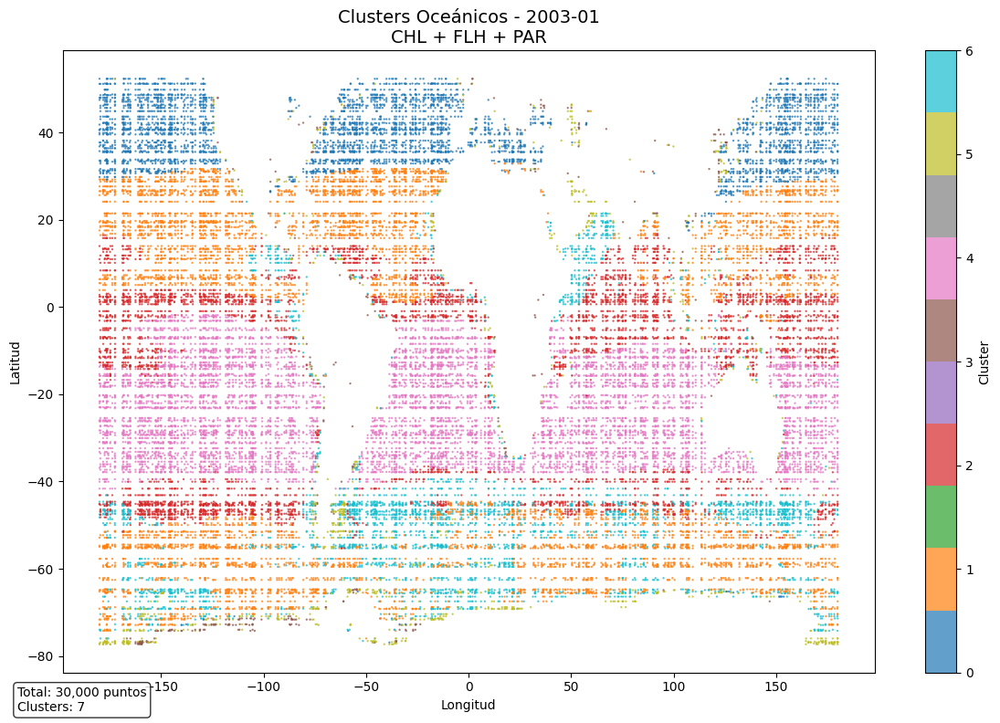


📊 ESTADÍSTICAS - 2003-01
Total puntos: 30,000
Cluster 0: 4,243 pts (14.1%)
Cluster 1: 7,426 pts (24.8%)
Cluster 2: 5,157 pts (17.2%)
Cluster 3: 342 pts (1.1%)
Cluster 4: 8,089 pts (27.0%)
Cluster 5: 1,035 pts (3.5%)
Cluster 6: 3,708 pts (12.4%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2003_01.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2003-01

📍 Progreso: 1/276 meses

📅 PROCESANDO: 2003-02
📥 Cargando datos para 2003-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030201_20220228.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030201_20220228.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ Datos combinados: FrozenMappingWarningOnValuesAccess({'lat': 5284, 'lon': 10516, 'time': 2})
⚠️  Muchos puntos (82230), muestreando a 30000
✅ Datos para clus

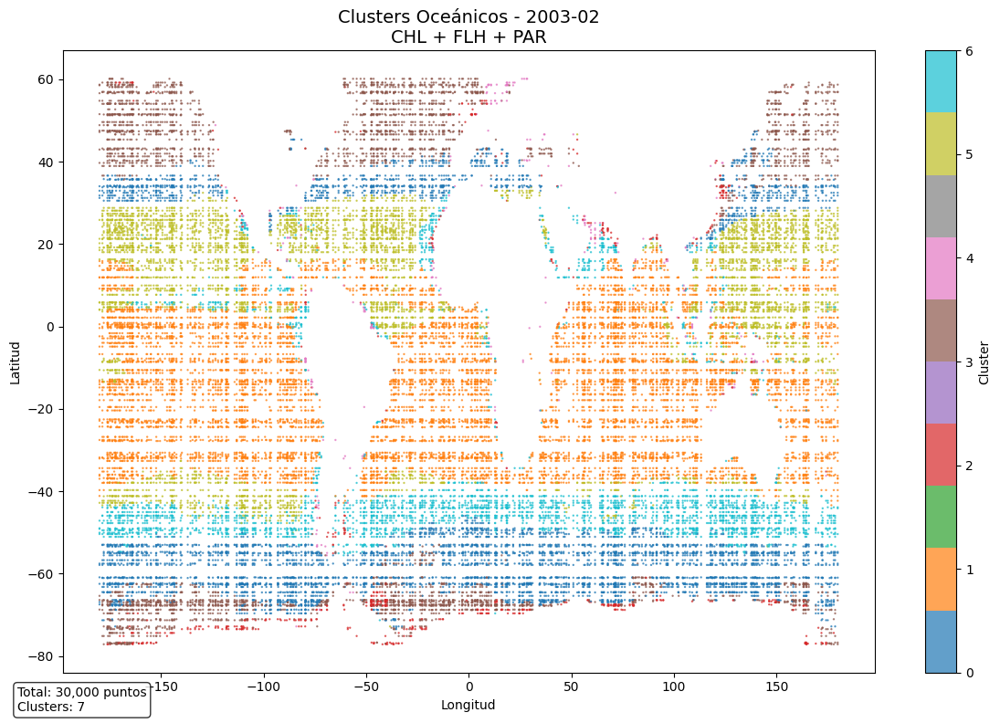


📊 ESTADÍSTICAS - 2003-02
Total puntos: 30,000
Cluster 0: 5,855 pts (19.5%)
Cluster 1: 9,661 pts (32.2%)
Cluster 2: 726 pts (2.4%)
Cluster 3: 4,147 pts (13.8%)
Cluster 4: 288 pts (1.0%)
Cluster 5: 5,598 pts (18.7%)
Cluster 6: 3,725 pts (12.4%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2003_02.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2003-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 2/276 meses

📅 PROCESANDO: 2003-03
📥 Cargando datos para 2003-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030321_20220620.L3m.SCSP.FLH.ipar.4km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030321_20240620.L3m.SCSP.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030321_20240620.L3m.SCSP.FLH.ipar.4km.nc
❌ No se pudo abrir AQUA_MODIS.20030321_20240620.L3m.SCSP.FLH.nflh.9km.nc con ning

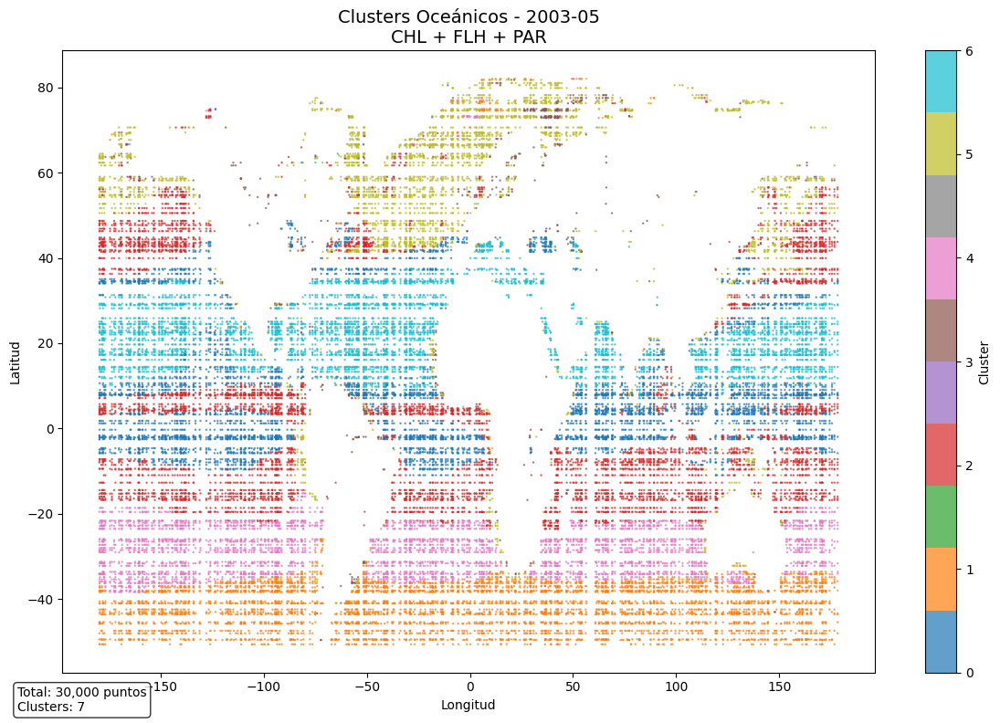


📊 ESTADÍSTICAS - 2003-05
Total puntos: 30,000
Cluster 0: 5,511 pts (18.4%)
Cluster 1: 5,104 pts (17.0%)
Cluster 2: 6,316 pts (21.1%)
Cluster 3: 576 pts (1.9%)
Cluster 4: 3,982 pts (13.3%)
Cluster 5: 3,420 pts (11.4%)
Cluster 6: 5,091 pts (17.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2003_05.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2003-05

📍 Progreso: 3/276 meses

📅 PROCESANDO: 2003-06
📥 Cargando datos para 2003-06...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030601_20220630.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ Datos combinados: FrozenMappingWarningOnValuesAccess({'lat': 5262, 'lon': 10484, 'time': 2})
⚠️  Muchos puntos (71115), muestreando a 30000
✅ Datos para clustering: (30000, 3)
✅ Coordenadas: lat (30000,), lon (30000,)
🧹 Memoria liberada
🔍 Da

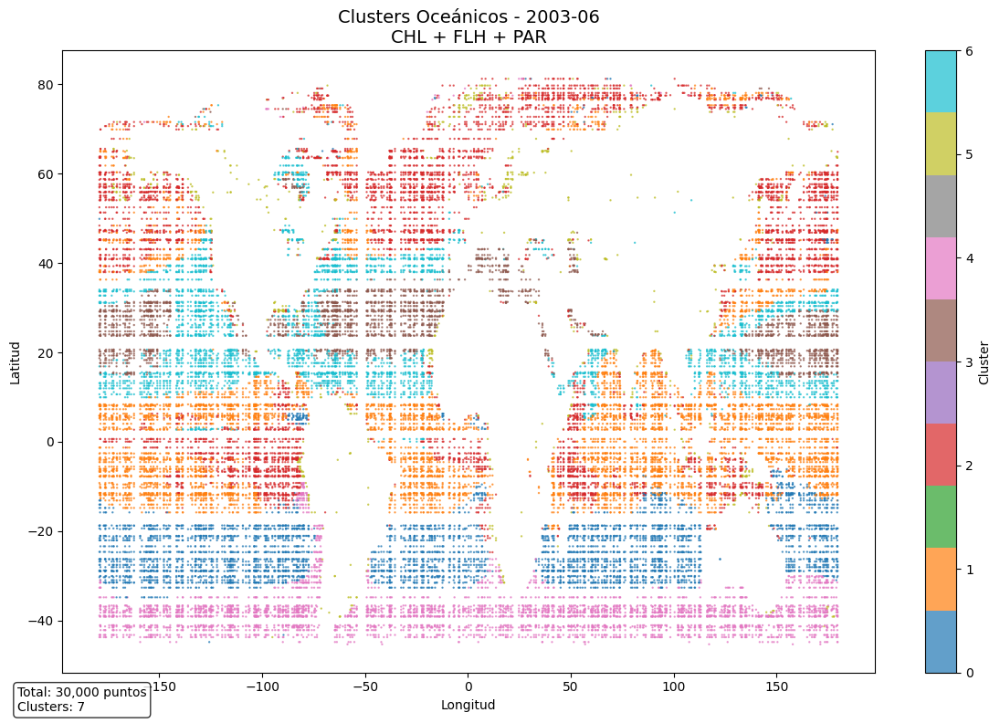


📊 ESTADÍSTICAS - 2003-06
Total puntos: 30,000
Cluster 0: 4,528 pts (15.1%)
Cluster 1: 7,254 pts (24.2%)
Cluster 2: 6,497 pts (21.7%)
Cluster 3: 2,716 pts (9.1%)
Cluster 4: 4,037 pts (13.5%)
Cluster 5: 871 pts (2.9%)
Cluster 6: 4,097 pts (13.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2003_06.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2003-06
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 4/276 meses

📅 PROCESANDO: 2003-07
📥 Cargando datos para 2003-07...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2003-07

📍 Progreso: 4/276 meses

📅 PROCESANDO: 2003-08
📥 Cargando datos para 2003-08...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archi

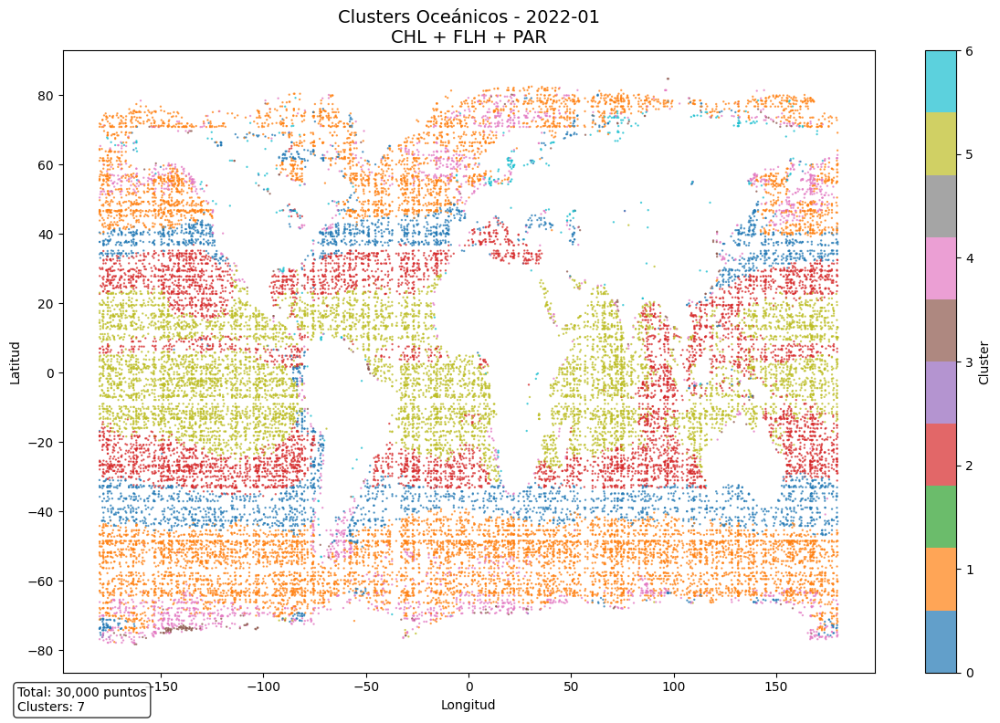


📊 ESTADÍSTICAS - 2022-01
Total puntos: 30,000
Cluster 0: 3,717 pts (12.4%)
Cluster 1: 9,530 pts (31.8%)
Cluster 2: 6,303 pts (21.0%)
Cluster 3: 210 pts (0.7%)
Cluster 4: 2,199 pts (7.3%)
Cluster 5: 7,740 pts (25.8%)
Cluster 6: 301 pts (1.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2022_01.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2022-01

📍 Progreso: 5/276 meses

📅 PROCESANDO: 2022-02
📥 Cargando datos para 2022-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2022-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 5/276 meses

📅 PROCESANDO: 2022-03
📥 Cargando datos para 2022-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos

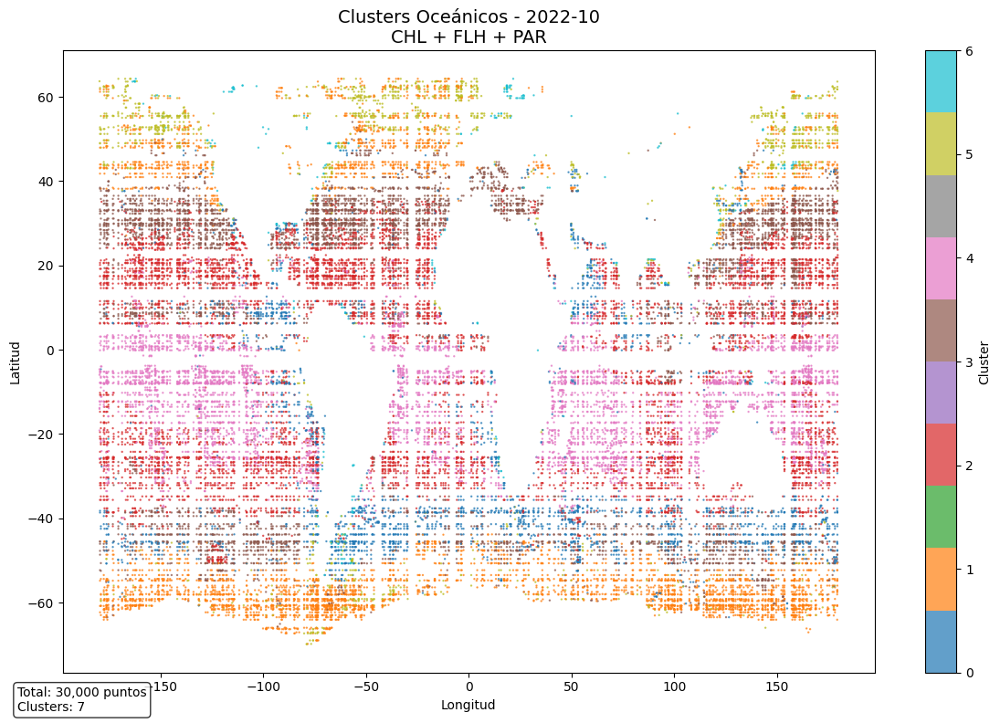


📊 ESTADÍSTICAS - 2022-10
Total puntos: 30,000
Cluster 0: 3,107 pts (10.4%)
Cluster 1: 5,198 pts (17.3%)
Cluster 2: 7,791 pts (26.0%)
Cluster 3: 6,322 pts (21.1%)
Cluster 4: 5,497 pts (18.3%)
Cluster 5: 1,766 pts (5.9%)
Cluster 6: 319 pts (1.1%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2022_10.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2022-10
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 6/276 meses

📅 PROCESANDO: 2022-11
📥 Cargando datos para 2022-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2022-11

📍 Progreso: 6/276 meses

📅 PROCESANDO: 2022-12
📥 Cargando datos para 2022-12...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archi

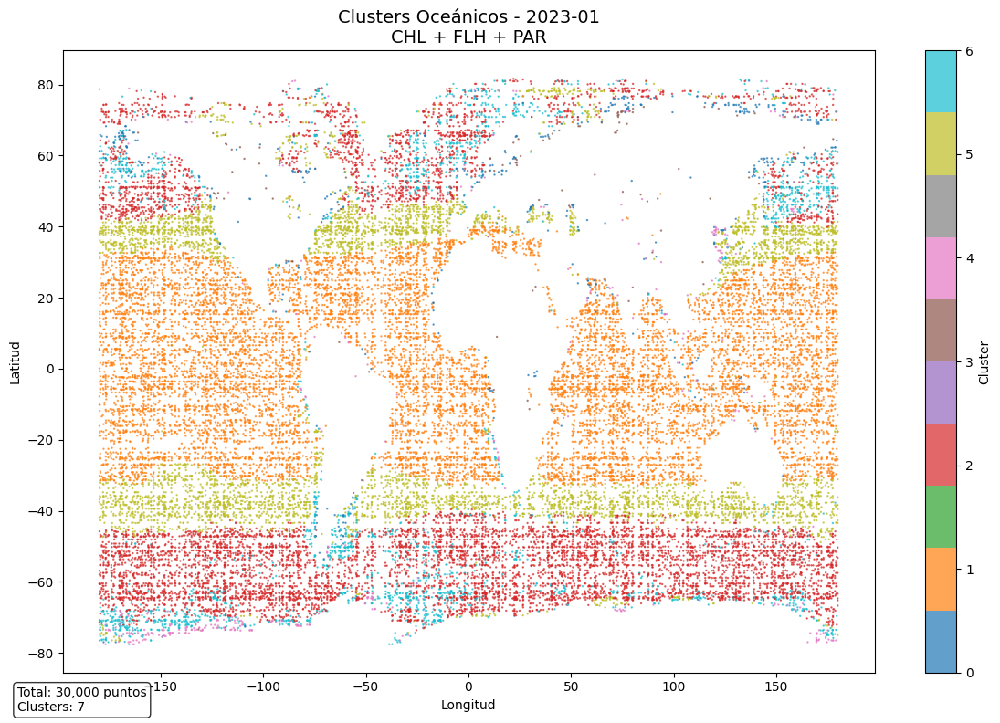


📊 ESTADÍSTICAS - 2023-01
Total puntos: 30,000
Cluster 0: 524 pts (1.7%)
Cluster 1: 12,016 pts (40.1%)
Cluster 2: 8,846 pts (29.5%)
Cluster 3: 112 pts (0.4%)
Cluster 4: 434 pts (1.4%)
Cluster 5: 5,698 pts (19.0%)
Cluster 6: 2,370 pts (7.9%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2023_01.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2023-01

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2023-02
📥 Cargando datos para 2023-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2023-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2023-03
📥 Cargando datos para 2023-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos e

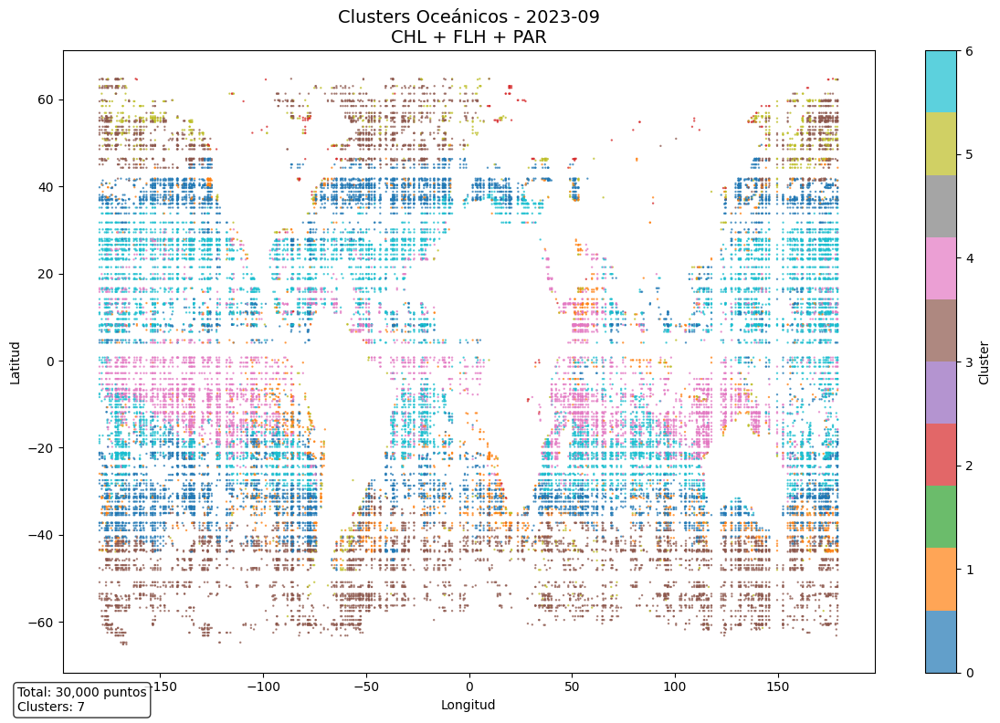


📊 ESTADÍSTICAS - 2023-09
Total puntos: 30,000
Cluster 0: 7,533 pts (25.1%)
Cluster 1: 2,183 pts (7.3%)
Cluster 2: 177 pts (0.6%)
Cluster 3: 6,372 pts (21.2%)
Cluster 4: 4,753 pts (15.8%)
Cluster 5: 1,083 pts (3.6%)
Cluster 6: 7,899 pts (26.3%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2023_09.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2023-09

📍 Progreso: 8/276 meses

📅 PROCESANDO: 2023-10
📥 Cargando datos para 2023-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20231001_20231031.L3m.MO.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231005.L3m.DAY.FLH.ipar.4km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231005.L3m.DAY.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231001_20231031.L3m.MO.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ Dato

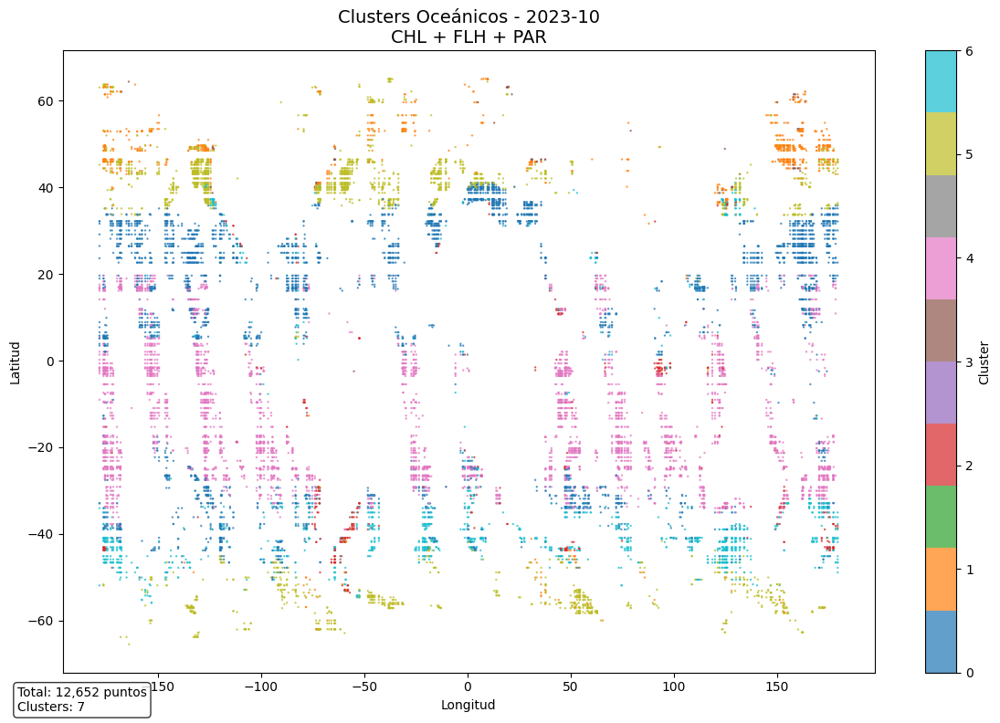


📊 ESTADÍSTICAS - 2023-10
Total puntos: 12,652
Cluster 0: 3,646 pts (28.8%)
Cluster 1: 868 pts (6.9%)
Cluster 2: 400 pts (3.2%)
Cluster 3: 98 pts (0.8%)
Cluster 4: 3,900 pts (30.8%)
Cluster 5: 2,280 pts (18.0%)
Cluster 6: 1,460 pts (11.5%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2023_10.csv (12,652 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2023-10
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 9/276 meses

📅 PROCESANDO: 2023-11
📥 Cargando datos para 2023-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2023-11

📍 Progreso: 9/276 meses

📅 PROCESANDO: 2023-12
📥 Cargando datos para 2023-12...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en

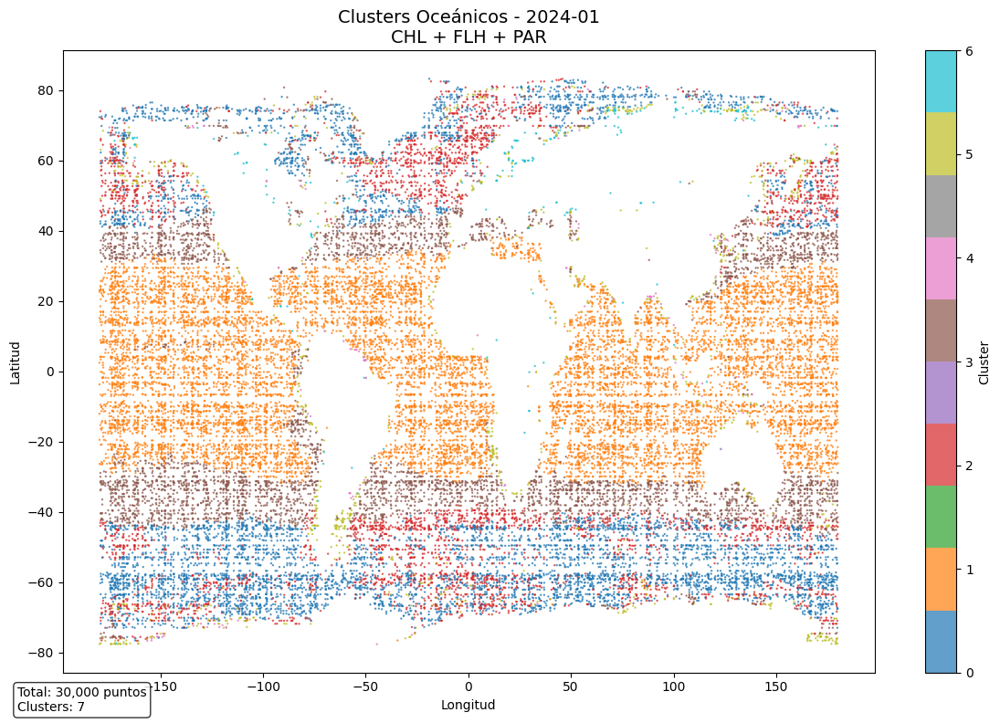


📊 ESTADÍSTICAS - 2024-01
Total puntos: 30,000
Cluster 0: 6,907 pts (23.0%)
Cluster 1: 12,311 pts (41.0%)
Cluster 2: 4,159 pts (13.9%)
Cluster 3: 5,140 pts (17.1%)
Cluster 4: 148 pts (0.5%)
Cluster 5: 1,098 pts (3.7%)
Cluster 6: 237 pts (0.8%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2024_01.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2024-01

📍 Progreso: 10/276 meses

📅 PROCESANDO: 2024-02
📥 Cargando datos para 2024-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2024-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 10/276 meses

📅 PROCESANDO: 2024-03
📥 Cargando datos para 2024-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archi

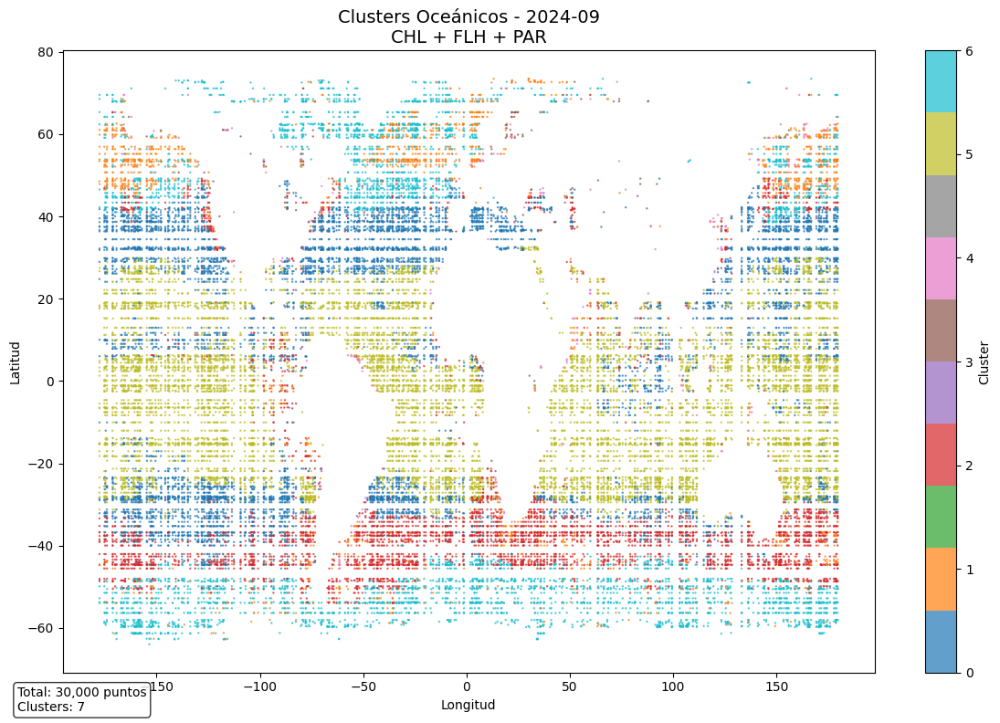


📊 ESTADÍSTICAS - 2024-09
Total puntos: 30,000
Cluster 0: 7,850 pts (26.2%)
Cluster 1: 2,028 pts (6.8%)
Cluster 2: 4,729 pts (15.8%)
Cluster 3: 133 pts (0.4%)
Cluster 4: 305 pts (1.0%)
Cluster 5: 9,949 pts (33.2%)
Cluster 6: 5,006 pts (16.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2024_09.csv (30,000 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2024-09

📍 Progreso: 11/276 meses

📅 PROCESANDO: 2024-10
📥 Cargando datos para 2024-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20241001_20241031.L3m.MO.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20241005.L3m.DAY.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20241001_20241031.L3m.MO.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ Datos combinados: FrozenMappingWarningOnValuesAccess({'lat': 4243, 'lon': 8520, 't

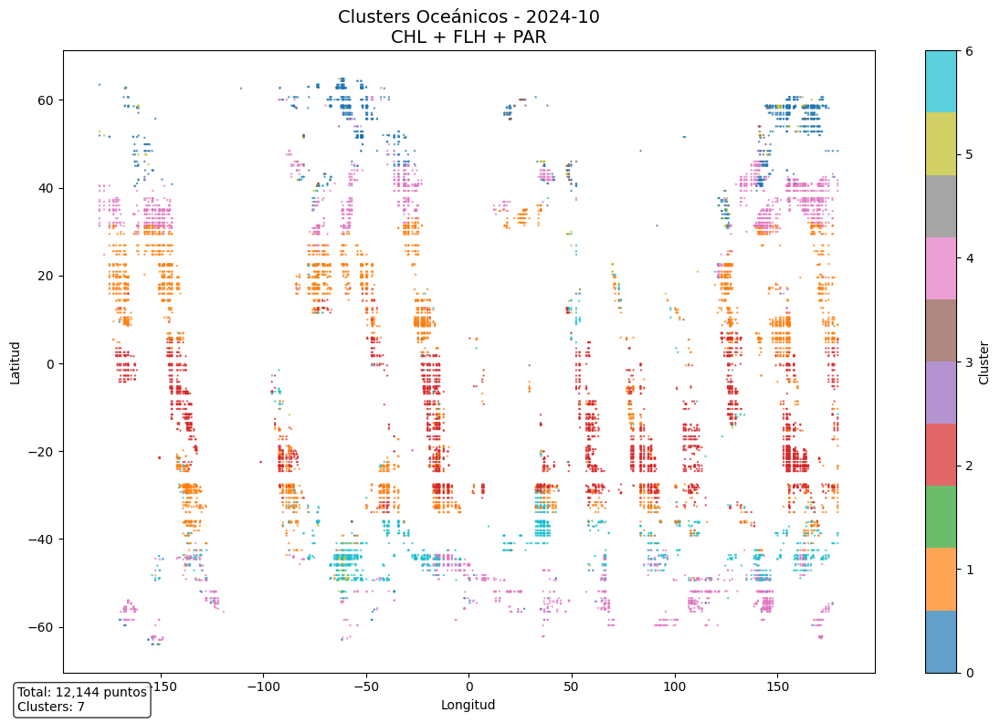


📊 ESTADÍSTICAS - 2024-10
Total puntos: 12,144
Cluster 0: 1,057 pts (8.7%)
Cluster 1: 3,689 pts (30.4%)
Cluster 2: 3,201 pts (26.4%)
Cluster 3: 101 pts (0.8%)
Cluster 4: 2,505 pts (20.6%)
Cluster 5: 181 pts (1.5%)
Cluster 6: 1,410 pts (11.6%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results/clusters_2024_10.csv (12,144 registros)
🧹 Memoria liberada
✅ COMPLETADO: 2024-10
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 12/276 meses

📅 PROCESANDO: 2024-11
📥 Cargando datos para 2024-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
❌ No hay datos CHL para 2024-11

📍 Progreso: 12/276 meses

📅 PROCESANDO: 2024-12
📥 Cargando datos para 2024-12...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archiv

In [ ]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MiniBatchKMeans
import gc
import warnings
warnings.filterwarnings('ignore')

# Configuración de carpetas
chl_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527"
flh_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_FLH_2022.0-20251004_024829"
par_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_PAR_2022.0-20251004_025127"

# Configuración de parámetros
target_months = list(range(1, 13))  # Todos los meses
target_years = list(range(2003, 2026))  # Todos los años
spatial_frac = 0.5
n_clusters = 7
max_points_per_month = 30000

# Verificar y montar Google Drive
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    print("✅ Google Drive montado correctamente")
except:
    print("⚠️  No se pudo montar Google Drive")

def robust_file_loading(folder, var_name, month, year, spatial_frac=0.2):
    """
    Versión robusta para carga de archivos con manejo de errores mejorado
    """
    datasets = []
    files_processed = 0

    # Verificar que la carpeta existe y es accesible
    if not os.path.exists(folder):
        print(f"❌ Carpeta no encontrada: {folder}")
        return datasets

    try:
        files = os.listdir(folder)
        print(f"📁 Encontrados {len(files)} archivos en {os.path.basename(folder)}")
    except OSError as e:
        print(f"❌ Error accediendo a la carpeta {folder}: {e}")
        return datasets

    for f in files:
        if not f.endswith(".nc"):
            continue

        try:
            # Extraer fecha del nombre del archivo de forma más robusta
            parts = f.split(".")
            if len(parts) < 2:
                continue

            date_str = parts[1]  # '20030101_20220131'
            y = int(date_str[:4])
            m = int(date_str[4:6])

            if y != year or m != month:
                continue

        except (ValueError, IndexError) as e:
            continue

        path = os.path.join(folder, f)

        try:
            # Intentar diferentes motores para abrir el archivo NetCDF
            ds = None
            for engine in ['netcdf4', 'h5netcdf', 'scipy']:
                try:
                    ds = xr.open_dataset(path, engine=engine, chunks={'lat': 50, 'lon': 50})
                    break
                except Exception as engine_error:
                    continue

            if ds is None:
                print(f"❌ No se pudo abrir {f} con ningún motor")
                continue

            if var_name not in ds:
                print(f"❌ Variable {var_name} no encontrada en {f}")
                ds.close()
                continue

            # Verificar coordenadas
            if "lat" not in ds or "lon" not in ds:
                print(f"❌ Coordenadas faltantes en {f}")
                ds.close()
                continue

            lat = ds["lat"].values
            lon = ds["lon"].values

            if len(lat) < 5 or len(lon) < 5:
                print(f"⚠️  Coordenadas insuficientes en {f}")
                ds.close()
                continue

            # Muestreo espacial
            n_lat = max(1, int(len(lat) * spatial_frac))
            n_lon = max(1, int(len(lon) * spatial_frac))

            try:
                lat_idx = np.sort(np.random.choice(len(lat), n_lat, replace=False))
                lon_idx = np.sort(np.random.choice(len(lon), n_lon, replace=False))
            except ValueError as e:
                print(f"❌ Error en muestreo de {f}: {e}")
                ds.close()
                continue

            # Cargar subconjunto de datos
            try:
                sub_ds = ds[[var_name]].isel(lat=lat_idx, lon=lon_idx).load()
                datasets.append(sub_ds)
                files_processed += 1
            except Exception as load_error:
                print(f"❌ Error cargando datos de {f}: {load_error}")
                ds.close()
                continue

            ds.close()

            # Límite de archivos por variable
            if files_processed >= 2:  # Reducido a 2 para mayor estabilidad
                break

        except Exception as e:
            print(f"❌ Error procesando {f}: {e}")
            continue

    return datasets

def load_and_combine_monthly_data_optimized(month, year, spatial_frac=0.2):
    """
    Versión optimizada para carga mensual con mejor manejo de errores
    """
    print(f"📥 Cargando datos para {year}-{month:02d}...")

    # Cargar datos con manejo robusto de errores
    chl_datasets = robust_file_loading(chl_folder, "chlor_a", month, year, spatial_frac)
    flh_datasets = robust_file_loading(flh_folder, "nflh", month, year, spatial_frac)
    par_datasets = robust_file_loading(par_folder, "par", month, year, spatial_frac)

    # Verificar que tenemos al menos un archivo por variable
    if not chl_datasets:
        print(f"❌ No hay datos CHL para {year}-{month:02d}")
        return None
    if not flh_datasets:
        print(f"❌ No hay datos FLH para {year}-{month:02d}")
        return None
    if not par_datasets:
        print(f"❌ No hay datos PAR para {year}-{month:02d}")
        return None

    try:
        # Combinar datasets individuales
        chl_combined = xr.concat(chl_datasets, dim="time")
        flh_combined = xr.concat(flh_datasets, dim="time")
        par_combined = xr.concat(par_datasets, dim="time")

        # Limpiar memoria
        del chl_datasets, flh_datasets, par_datasets
        gc.collect()

        # Renombrar variables
        chl_combined = chl_combined.rename({'chlor_a': 'chl'})
        flh_combined = flh_combined.rename({'nflh': 'flh'})
        par_combined = par_combined.rename({'par': 'par'})

        # Combinar todas las variables
        merged = xr.merge([chl_combined, flh_combined, par_combined], compat='override')

        print(f"✅ Datos combinados: {merged.dims}")
        return merged

    except Exception as e:
        print(f"❌ Error combinando datos: {e}")
        return None

def process_data_for_clustering_optimized(merged_ds, max_points=50000):
    """
    Versión CORREGIDA del procesamiento que asegura dimensiones consistentes
    """
    if merged_ds is None:
        return None, None, None

    try:
        # Stack dimensiones
        stacked = merged_ds.stack(points=("lat", "lon", "time"))

        # Filtrar puntos válidos en LAS TRES variables simultáneamente
        valid_mask = (~xr.ufuncs.isnan(stacked["chl"])) & \
                    (~xr.ufuncs.isnan(stacked["flh"])) & \
                    (~xr.ufuncs.isnan(stacked["par"]))

        # Aplicar máscara para mantener solo puntos válidos
        stacked_valid = stacked.where(valid_mask, drop=True)

        if len(stacked_valid.points) == 0:
            print("❌ No hay puntos válidos después del filtrado")
            return None, None, None

        # LIMITAR número de puntos para evitar memoria
        n_points = len(stacked_valid.points)
        if n_points > max_points:
            print(f"⚠️  Muchos puntos ({n_points}), muestreando a {max_points}")
            idx = np.random.choice(n_points, max_points, replace=False)
            stacked_valid = stacked_valid.isel(points=idx)

        # Extraer datos
        variables = ["chl", "flh", "par"]

        chl_values = stacked_valid["chl"].values
        flh_values = stacked_valid["flh"].values
        par_values = stacked_valid["par"].values
        lat_values = stacked_valid["lat"].values
        lon_values = stacked_valid["lon"].values

        # Verificar dimensiones consistentes
        lengths = [len(chl_values), len(flh_values), len(par_values), len(lat_values), len(lon_values)]
        if len(set(lengths)) != 1:
            print(f"❌ Error: Dimensiones inconsistentes {lengths}")
            min_length = min(lengths)
            chl_values = chl_values[:min_length]
            flh_values = flh_values[:min_length]
            par_values = par_values[:min_length]
            lat_values = lat_values[:min_length]
            lon_values = lon_values[:min_length]
            print(f"✅ Ajustado a longitud común: {min_length}")

        # Crear array de características
        X_clean = np.column_stack([chl_values, flh_values, par_values])

        print(f"✅ Datos para clustering: {X_clean.shape}")
        print(f"✅ Coordenadas: lat {lat_values.shape}, lon {lon_values.shape}")

        # Verificación final
        assert len(X_clean) == len(lat_values) == len(lon_values), \
            f"Dimensiones finales inconsistentes"

        # Liberar memoria
        del stacked, stacked_valid
        gc.collect()

        return X_clean, lat_values, lon_values

    except Exception as e:
        print(f"❌ Error en procesamiento: {e}")
        return None, None, None

def perform_clustering_optimized(X_clean, lat_clean, lon_clean, n_clusters=7):
    """
    Versión optimizada del clustering con manejo robusto de dimensiones
    """
    if X_clean is None or len(X_clean) == 0:
        return None, None, None

    try:
        # Verificación de dimensiones
        if len(X_clean) != len(lat_clean) or len(X_clean) != len(lon_clean):
            print(f"❌ Dimensiones inconsistentes al inicio de clustering")
            min_len = min(len(X_clean), len(lat_clean), len(lon_clean))
            X_clean = X_clean[:min_len]
            lat_clean = lat_clean[:min_len]
            lon_clean = lon_clean[:min_len]
            print(f"✅ Ajustado a longitud común: {min_len}")

        # Limpiar NaN
        valid_mask = ~np.isnan(X_clean).any(axis=1)
        X_clean_filtered = X_clean[valid_mask]
        lat_clean_filtered = lat_clean[valid_mask]
        lon_clean_filtered = lon_clean[valid_mask]

        if len(X_clean_filtered) == 0:
            print("❌ No hay datos válidos después de limpieza NaN")
            return None, None, None

        print(f"🔍 Datos limpios para clustering: {X_clean_filtered.shape}")

        # Muestreo si es necesario
        if len(X_clean_filtered) > 30000:
            print(f"⚠️  Muestreando datos de {len(X_clean_filtered)} a 30000")
            idx = np.random.choice(len(X_clean_filtered), 30000, replace=False)
            X_clean_filtered = X_clean_filtered[idx]
            lat_clean_filtered = lat_clean_filtered[idx]
            lon_clean_filtered = lon_clean_filtered[idx]

        # Escalar
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_clean_filtered)

        # Escalar coordenadas
        lat_scaled = (lat_clean_filtered - lat_clean_filtered.mean()) / lat_clean_filtered.std()
        lon_scaled = (lon_clean_filtered - lon_clean_filtered.mean()) / lon_clean_filtered.std()

        # Combinar
        X_final = np.column_stack([X_scaled, 0.05 * lat_scaled, 0.05 * lon_scaled])

        print(f"📊 Datos finales: {X_final.shape}")

        # Clustering
        kmeans = MiniBatchKMeans(
            n_clusters=n_clusters,
            batch_size=min(1000, len(X_final)),
            random_state=42,
            n_init=3,
            max_iter=100,
            tol=1e-3
        )

        print("🎯 Entrenando MiniBatchKMeans...")
        kmeans.fit(X_final)
        labels = kmeans.labels_

        print(f"✅ Clusters encontrados: {np.unique(labels)}")

        return labels, lat_clean_filtered, lon_clean_filtered

    except Exception as e:
        print(f"❌ Error en clustering: {e}")
        return None, None, None

def lightweight_visualization(lat_clean, lon_clean, labels, month, year):
    """
    Visualización ligera con solo el mapa esencial
    """
    if labels is None:
        print("❌ No hay clusters para visualizar")
        return

    try:
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes en visualización")
            return

        plt.figure(figsize=(12, 8))
        scatter = plt.scatter(lon_clean, lat_clean, c=labels,
                            s=0.5, cmap="tab10", alpha=0.7)
        plt.title(f'Clusters Oceánicos - {year}-{month:02d}\nCHL + FLH + PAR', fontsize=14)
        plt.xlabel("Longitud")
        plt.ylabel("Latitud")
        plt.colorbar(scatter, label="Cluster")

        unique_labels, counts = np.unique(labels, return_counts=True)
        stats_text = f"Total: {len(labels):,} puntos\nClusters: {len(unique_labels)}"
        plt.figtext(0.02, 0.02, stats_text, fontsize=10,
                   bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

        plt.tight_layout()
        plt.show()

        print(f"\n📊 ESTADÍSTICAS - {year}-{month:02d}")
        print("=" * 40)
        print(f"Total puntos: {len(labels):,}")
        for cluster_id, count in zip(unique_labels, counts):
            percentage = count/len(labels)*100
            print(f"Cluster {cluster_id}: {count:,} pts ({percentage:.1f}%)")

    except Exception as e:
        print(f"❌ Error en visualización: {e}")

def save_results_optimized(lat_clean, lon_clean, labels, month, year,
                          base_path="/content/drive/MyDrive/NASA Space Apps/results"):
    """
    Guardado optimizado con verificación de dimensiones
    """
    if labels is None:
        print("❌ No hay resultados para guardar")
        return None

    try:
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes al guardar")
            return None

        os.makedirs(base_path, exist_ok=True)

        if len(labels) > 100000:
            print(f"⚠️  Muchos datos ({len(labels)}), guardando muestra de 100k")
            idx = np.random.choice(len(labels), 100000, replace=False)
            results_df = pd.DataFrame({
                "lat": lat_clean[idx],
                "lon": lon_clean[idx],
                "cluster": labels[idx],
                "month": month,
                "year": year
            })
        else:
            results_df = pd.DataFrame({
                "lat": lat_clean,
                "lon": lon_clean,
                "cluster": labels,
                "month": month,
                "year": year
            })

        filename = f"clusters_{year}_{month:02d}.csv"
        filepath = os.path.join(base_path, filename)

        results_df.to_csv(filepath, index=False)
        print(f"💾 Guardado: {filepath} ({len(results_df):,} registros)")

        return filepath

    except Exception as e:
        print(f"❌ Error guardando: {e}")
        return None

def aggressive_memory_cleanup():
    """
    Limpieza agresiva de memoria
    """
    gc.collect()
    for i in range(3):
        gc.collect()
    print("🧹 Memoria liberada")

def process_single_month(year, month):
    """
    Procesa un solo mes con manejo robusto de errores
    """
    print(f"\n{'='*50}")
    print(f"📅 PROCESANDO: {year}-{month:02d}")
    print(f"{'='*50}")

    try:
        # 1. Cargar datos
        merged_ds = load_and_combine_monthly_data_optimized(month, year, spatial_frac)
        if merged_ds is None:
            return False

        # 2. Procesar para clustering
        X_clean, lat_clean, lon_clean = process_data_for_clustering_optimized(
            merged_ds, max_points_per_month)

        del merged_ds
        aggressive_memory_cleanup()

        if X_clean is None:
            return False

        # 3. Clustering
        clustering_result = perform_clustering_optimized(X_clean, lat_clean, lon_clean, n_clusters)

        del X_clean, lat_clean, lon_clean
        aggressive_memory_cleanup()

        if clustering_result is None:
            return False

        labels, lat_filtered, lon_filtered = clustering_result

        # 4. Visualización
        lightweight_visualization(lat_filtered, lon_filtered, labels, month, year)

        # 5. Guardar
        save_results_optimized(lat_filtered, lon_filtered, labels, month, year)

        # 6. Limpiar
        del labels, lat_filtered, lon_filtered
        aggressive_memory_cleanup()

        print(f"✅ COMPLETADO: {year}-{month:02d}")
        return True

    except Exception as e:
        print(f"❌ Error en {year}-{month:02d}: {str(e)}")
        aggressive_memory_cleanup()
        return False

# PROGRAMA PRINCIPAL OPTIMIZADO
def main_optimized():
    print("🚀 ANÁLISIS OPTIMIZADO CON MINIBATCHKMEANS")
    print("=" * 60)
    print(f"📅 Años: {len(target_years)} | Meses: {len(target_months)}")
    print(f"📊 Muestreo espacial: {spatial_frac}")
    print(f"🔢 Clusters: {n_clusters}")
    print(f"📈 Límite puntos/mes: {max_points_per_month:,}")
    print("=" * 60)

    successful_months = 0
    total_months = len(target_years) * len(target_months)

    for i, year in enumerate(target_years):
        print(f"\n📅 PROCESANDO AÑO {year} ({i+1}/{len(target_years)})")

        for j, month in enumerate(target_months):
            print(f"\n📍 Progreso: {successful_months}/{total_months} meses")

            if process_single_month(year, month):
                successful_months += 1

            # Pausa más frecuente para mayor estabilidad
            if (j + 1) % 2 == 0:
                print("⏸️  Pausa para estabilizar memoria...")
                aggressive_memory_cleanup()

    print(f"\n🎉 ANÁLISIS COMPLETADO!")
    print(f"✅ Meses exitosos: {successful_months}/{total_months}")
    print("=" * 60)

# Ejecutar versión optimizada
if __name__ == "__main__":
    main_optimized()

Mounted at /content/drive
✅ Google Drive montado correctamente
🚀 ANÁLISIS FLEXIBLE CON MINIBATCHKMEANS
📅 Años: 23 | Meses: 12
📊 Muestreo espacial: 0.5
🔢 Clusters: 7
📈 Límite puntos/mes: 30,000
💾 Destino: /content/drive/MyDrive/NASA Space Apps/results2

📅 PROCESANDO AÑO 2003 (1/23)

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-01
📥 Cargando datos para 2003-01...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ CHL disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 'lat': 1609, 'lon': 3227})
✅ FLH disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 'lat': 3240, 'lon': 6480})
✅ PAR disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 'lat': 1609, '

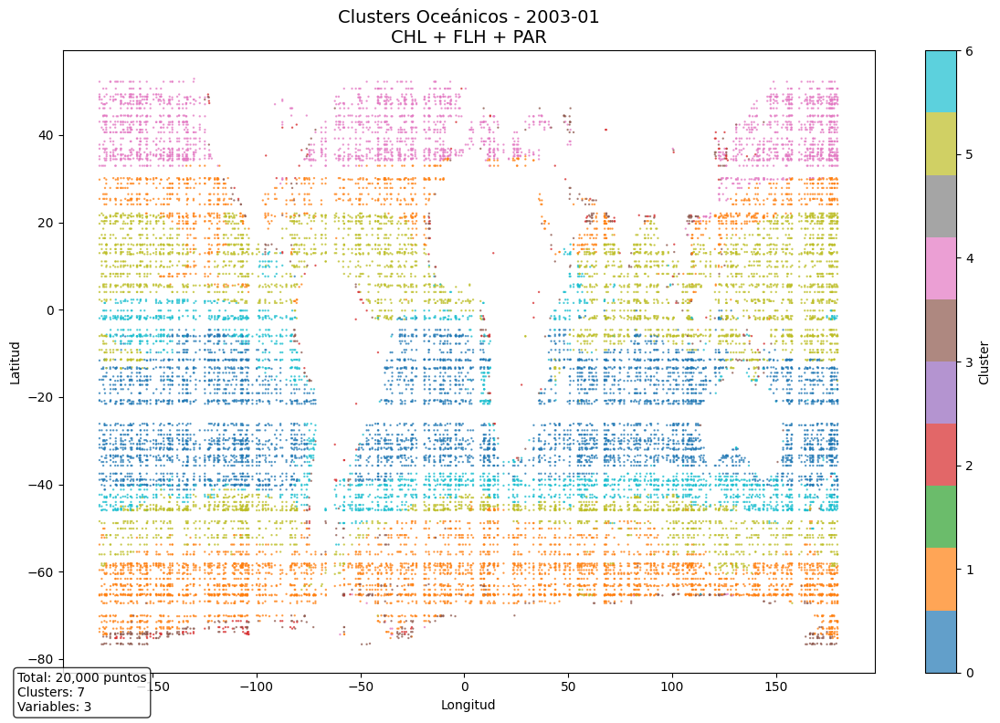


📊 ESTADÍSTICAS - 2003-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,067 pts (25.3%)
Cluster 1: 4,713 pts (23.6%)
Cluster 2: 191 pts (1.0%)
Cluster 3: 626 pts (3.1%)
Cluster 4: 2,330 pts (11.7%)
Cluster 5: 4,700 pts (23.5%)
Cluster 6: 2,373 pts (11.9%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-01 (3 variables)

📍 Progreso: 1/276 meses

📅 PROCESANDO: 2003-02
📥 Cargando datos para 2003-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030201_20220228.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030201_20220228.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ CHL disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 

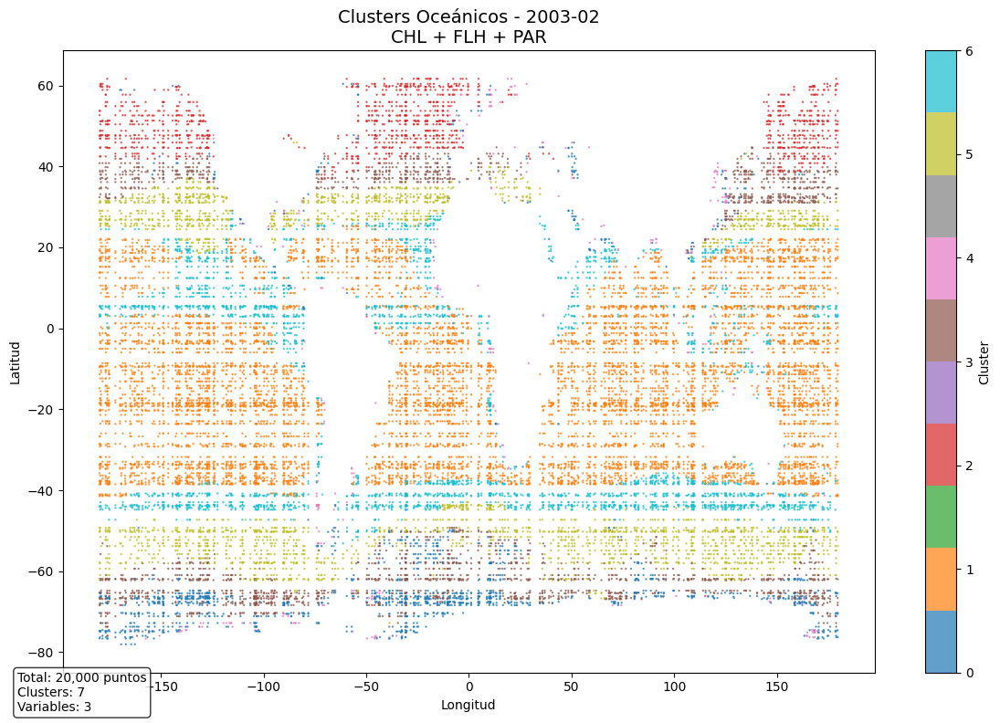


📊 ESTADÍSTICAS - 2003-02
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 1,495 pts (7.5%)
Cluster 1: 8,565 pts (42.8%)
Cluster 2: 1,259 pts (6.3%)
Cluster 3: 2,338 pts (11.7%)
Cluster 4: 304 pts (1.5%)
Cluster 5: 2,814 pts (14.1%)
Cluster 6: 3,225 pts (16.1%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_02.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-02 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 2/276 meses

📅 PROCESANDO: 2003-03
📥 Cargando datos para 2003-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ No se pudo abrir AQUA_MODIS.20030321_20220620.L3m.SCSP.FLH.nflh.9km.nc con ningún motor
❌ No se pudo abrir AQUA_MODIS.20030321_20220620.L3m.SCSP.FLH.ipar.4km.nc con ningún motor
❌ No se pudo abrir AQUA_MODIS.20030321_20240620.L3m.SCSP.FLH.ipar

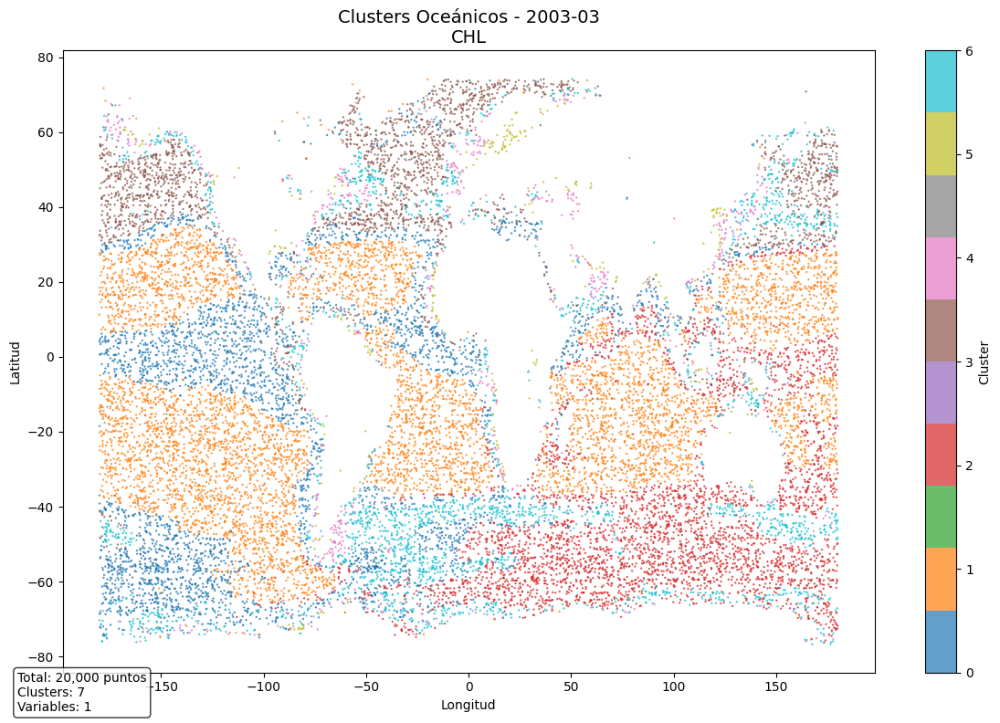


📊 ESTADÍSTICAS - 2003-03
Variables utilizadas: ['chl']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 3,659 pts (18.3%)
Cluster 1: 6,799 pts (34.0%)
Cluster 2: 3,706 pts (18.5%)
Cluster 3: 2,334 pts (11.7%)
Cluster 4: 756 pts (3.8%)
Cluster 5: 318 pts (1.6%)
Cluster 6: 2,428 pts (12.1%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_03.csv (20,000 registros, 1 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-03 (1 variables)

📍 Progreso: 3/276 meses

📅 PROCESANDO: 2003-04
📥 Cargando datos para 2003-04...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030401_20220430.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030401_20220430.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ CHL disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 'lat': 1624, '

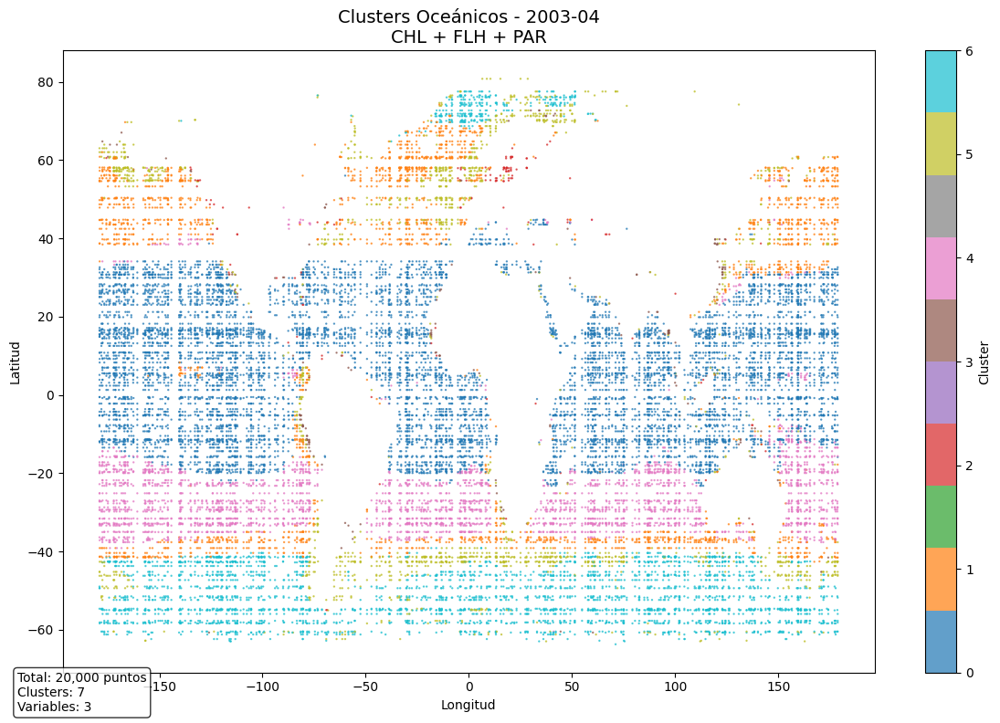


📊 ESTADÍSTICAS - 2003-04
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 8,891 pts (44.5%)
Cluster 1: 2,519 pts (12.6%)
Cluster 2: 142 pts (0.7%)
Cluster 3: 188 pts (0.9%)
Cluster 4: 3,171 pts (15.9%)
Cluster 5: 1,770 pts (8.8%)
Cluster 6: 3,319 pts (16.6%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_04.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-04 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 4/276 meses

📅 PROCESANDO: 2003-05
📥 Cargando datos para 2003-05...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030501_20220531.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030501_20220531.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ CHL dis

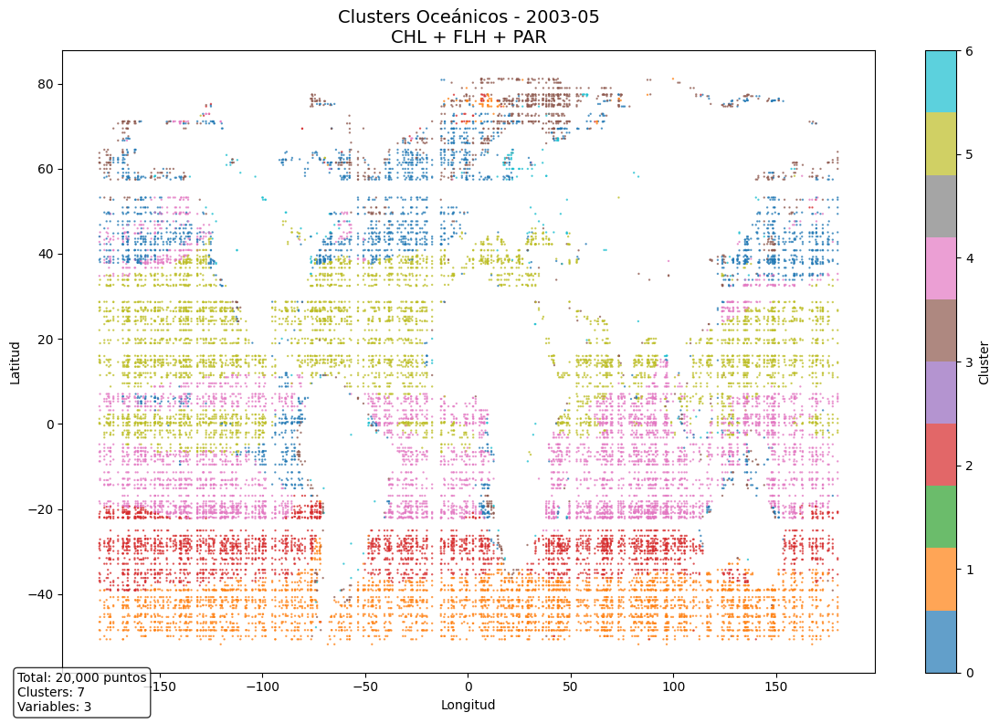


📊 ESTADÍSTICAS - 2003-05
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 2,428 pts (12.1%)
Cluster 1: 3,502 pts (17.5%)
Cluster 2: 2,869 pts (14.3%)
Cluster 3: 1,204 pts (6.0%)
Cluster 4: 5,050 pts (25.2%)
Cluster 5: 4,754 pts (23.8%)
Cluster 6: 193 pts (1.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_05.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-05 (3 variables)

📍 Progreso: 5/276 meses

📅 PROCESANDO: 2003-06
📥 Cargando datos para 2003-06...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20030601_20220630.L3m.MC.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
✅ CHL disponible: FrozenMappingWarningOnValuesAccess({'time': 2, 'lat': 3240, 'lon': 6480})
✅ FLH disponible: FrozenMappingWarningOnValuesAccess({'t

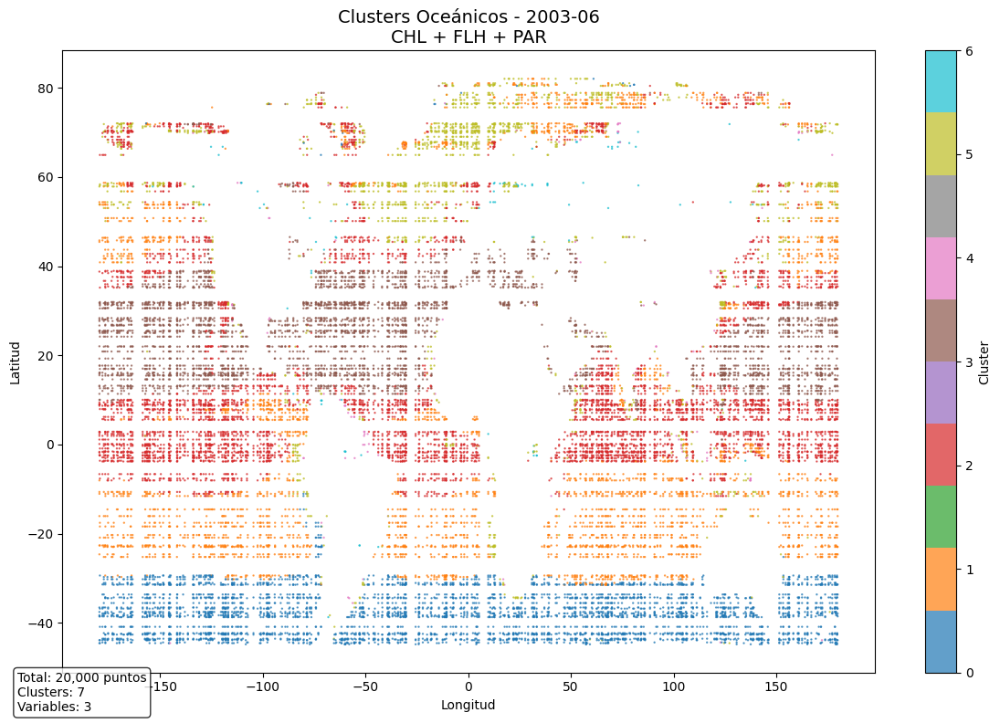


📊 ESTADÍSTICAS - 2003-06
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 4,040 pts (20.2%)
Cluster 1: 3,716 pts (18.6%)
Cluster 2: 6,038 pts (30.2%)
Cluster 3: 4,071 pts (20.4%)
Cluster 4: 131 pts (0.7%)
Cluster 5: 1,909 pts (9.5%)
Cluster 6: 95 pts (0.5%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_06.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-06 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 6/276 meses

📅 PROCESANDO: 2003-07
📥 Cargando datos para 2003-07...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2003-07
⚠️  No se pudo cargar datos para 2003-07

📍 Progreso: 6/276 meses

📅 PROCESANDO: 2003-08
📥 Cargando datos para 2003-08...
📁 Encontrado

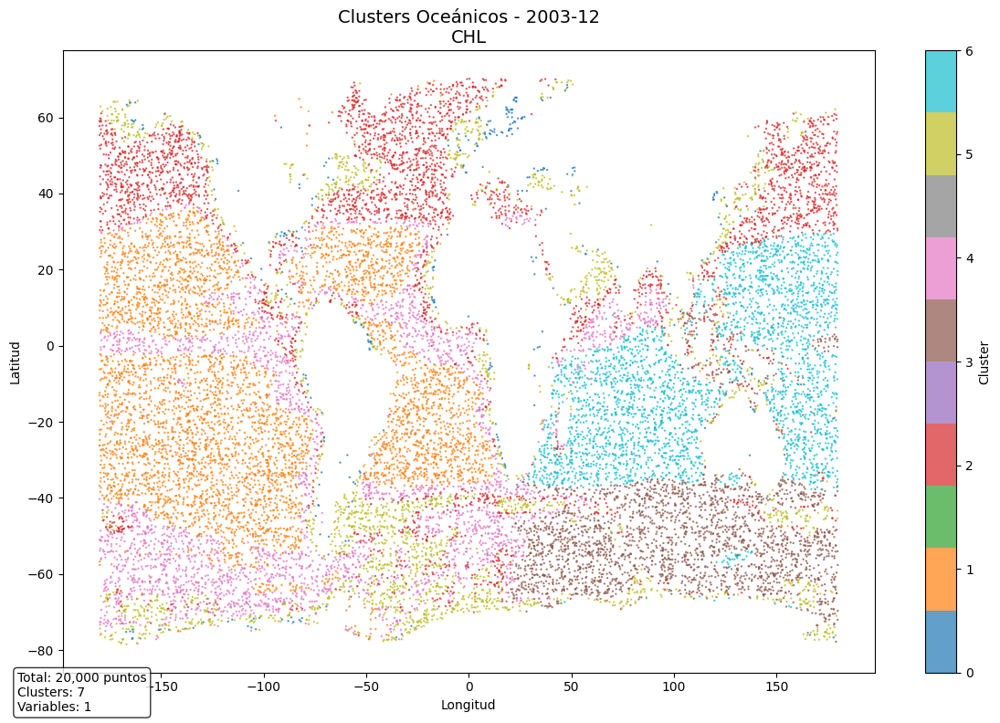


📊 ESTADÍSTICAS - 2003-12
Variables utilizadas: ['chl']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 333 pts (1.7%)
Cluster 1: 5,093 pts (25.5%)
Cluster 2: 3,705 pts (18.5%)
Cluster 3: 2,451 pts (12.3%)
Cluster 4: 3,046 pts (15.2%)
Cluster 5: 2,430 pts (12.2%)
Cluster 6: 2,942 pts (14.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_12.csv (20,000 registros, 1 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-12 (1 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📅 PROCESANDO AÑO 2004 (2/23)

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2004-01
📥 Cargando datos para 2004-01...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2004-01
⚠️  No se pudo cargar datos para 2004-01

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2004-02
📥 Cargando datos para 20

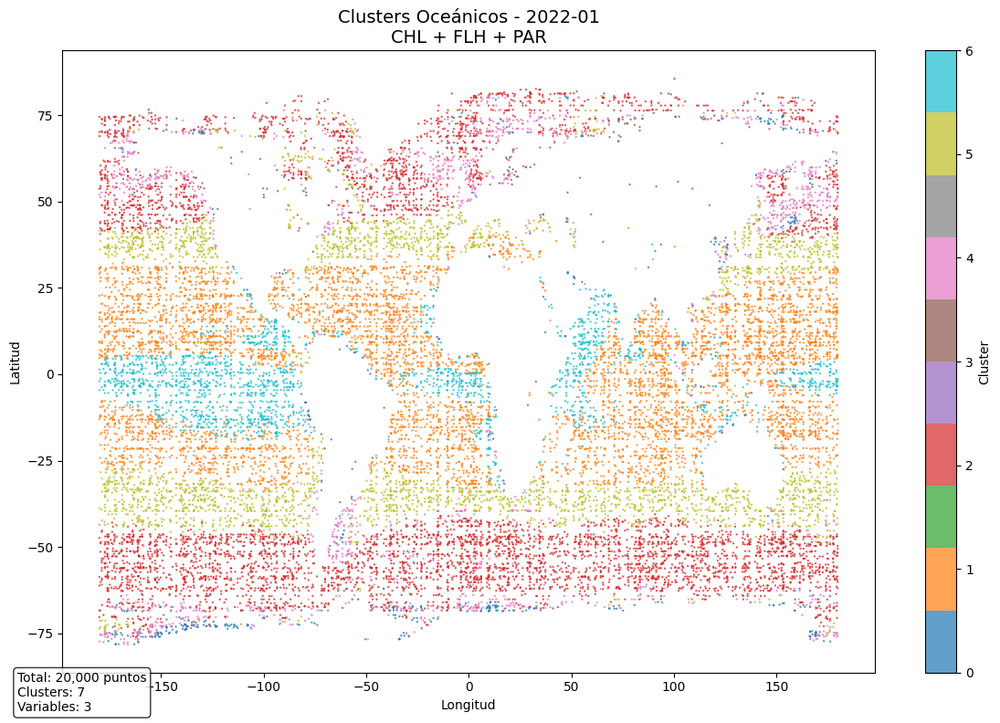


📊 ESTADÍSTICAS - 2022-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 455 pts (2.3%)
Cluster 1: 6,505 pts (32.5%)
Cluster 2: 5,685 pts (28.4%)
Cluster 3: 174 pts (0.9%)
Cluster 4: 1,743 pts (8.7%)
Cluster 5: 3,354 pts (16.8%)
Cluster 6: 2,084 pts (10.4%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2022_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2022-01 (3 variables)

📍 Progreso: 8/276 meses

📅 PROCESANDO: 2022-02
📥 Cargando datos para 2022-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2022-02
⚠️  No se pudo cargar datos para 2022-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 8/276 meses

📅 PROCESANDO: 2022-03
📥 Cargando datos para 2022-03...
📁 Encontrad

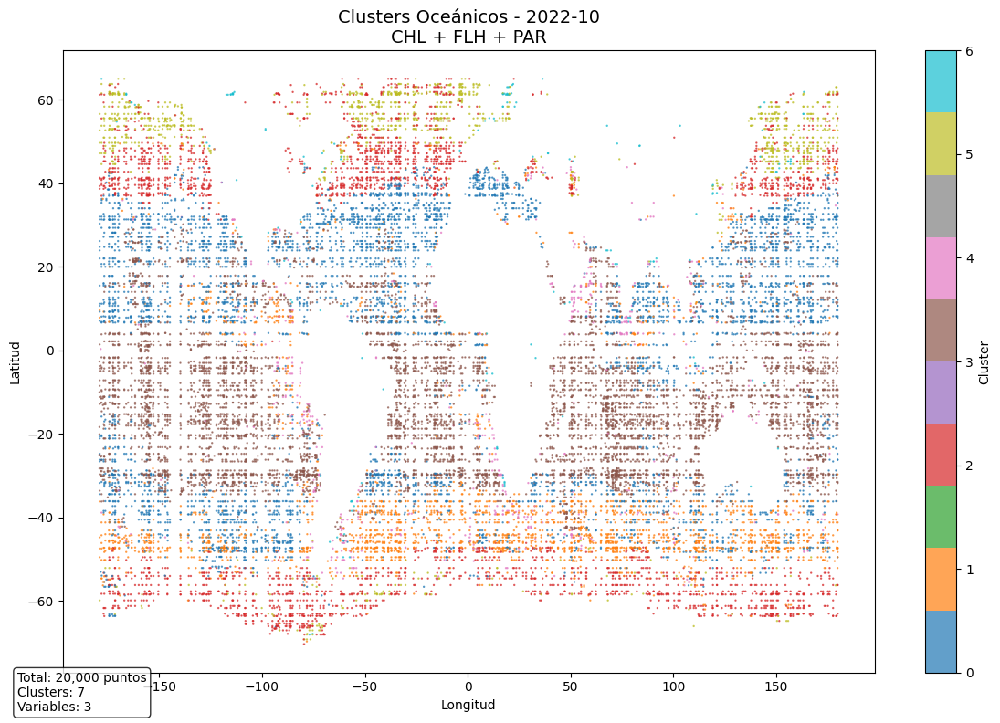


📊 ESTADÍSTICAS - 2022-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,368 pts (26.8%)
Cluster 1: 2,655 pts (13.3%)
Cluster 2: 3,073 pts (15.4%)
Cluster 3: 6,788 pts (33.9%)
Cluster 4: 686 pts (3.4%)
Cluster 5: 1,258 pts (6.3%)
Cluster 6: 172 pts (0.9%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2022_10.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2022-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 9/276 meses

📅 PROCESANDO: 2022-11
📥 Cargando datos para 2022-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2022-11
⚠️  No se pudo cargar datos para 2022-11

📍 Progreso: 9/276 meses

📅 PROCESANDO: 2022-12
📥 Cargando datos para 2022-12...
📁 Encontrad

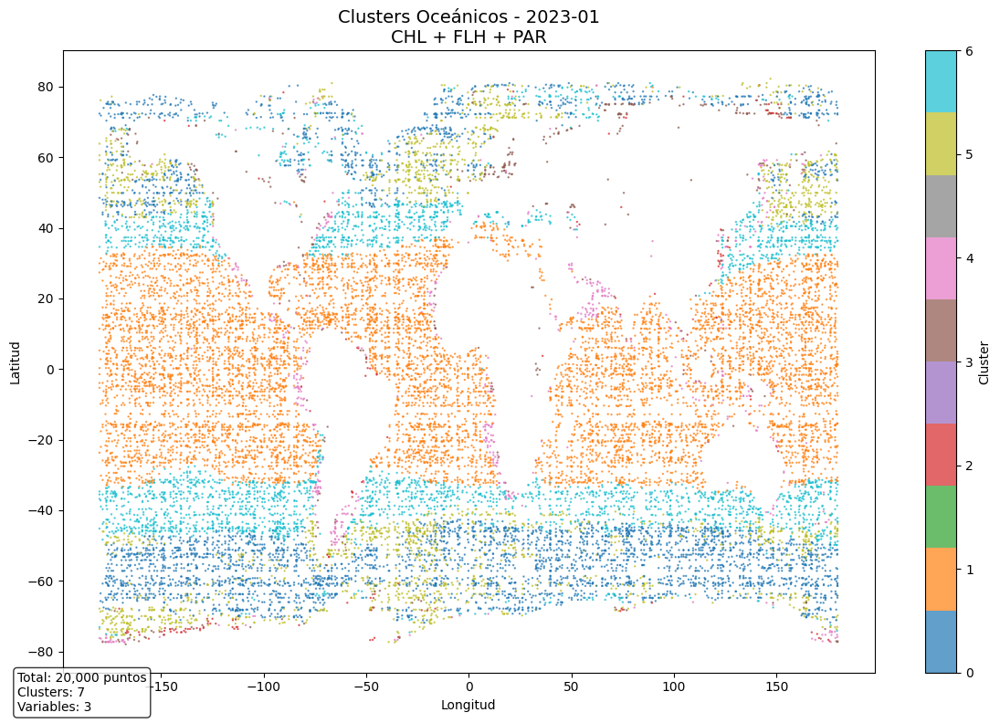


📊 ESTADÍSTICAS - 2023-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 4,456 pts (22.3%)
Cluster 1: 8,561 pts (42.8%)
Cluster 2: 151 pts (0.8%)
Cluster 3: 405 pts (2.0%)
Cluster 4: 614 pts (3.1%)
Cluster 5: 2,350 pts (11.8%)
Cluster 6: 3,463 pts (17.3%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-01 (3 variables)

📍 Progreso: 10/276 meses

📅 PROCESANDO: 2023-02
📥 Cargando datos para 2023-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2023-02
⚠️  No se pudo cargar datos para 2023-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 10/276 meses

📅 PROCESANDO: 2023-03
📥 Cargando datos para 2023-03...
📁 Encontrad

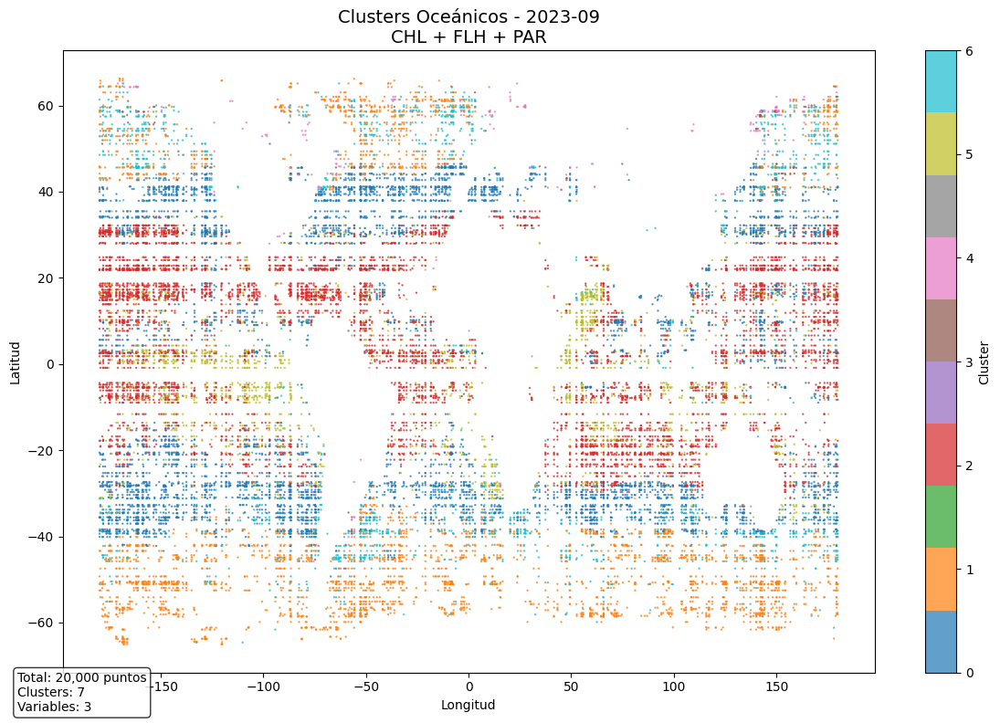


📊 ESTADÍSTICAS - 2023-09
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,651 pts (28.3%)
Cluster 1: 3,618 pts (18.1%)
Cluster 2: 6,024 pts (30.1%)
Cluster 3: 154 pts (0.8%)
Cluster 4: 233 pts (1.2%)
Cluster 5: 2,347 pts (11.7%)
Cluster 6: 1,973 pts (9.9%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_09.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-09 (3 variables)

📍 Progreso: 11/276 meses

📅 PROCESANDO: 2023-10
📥 Cargando datos para 2023-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20231001_20231031.L3m.MO.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231005.L3m.DAY.FLH.ipar.4km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231005.L3m.DAY.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20231001_20231031.L3

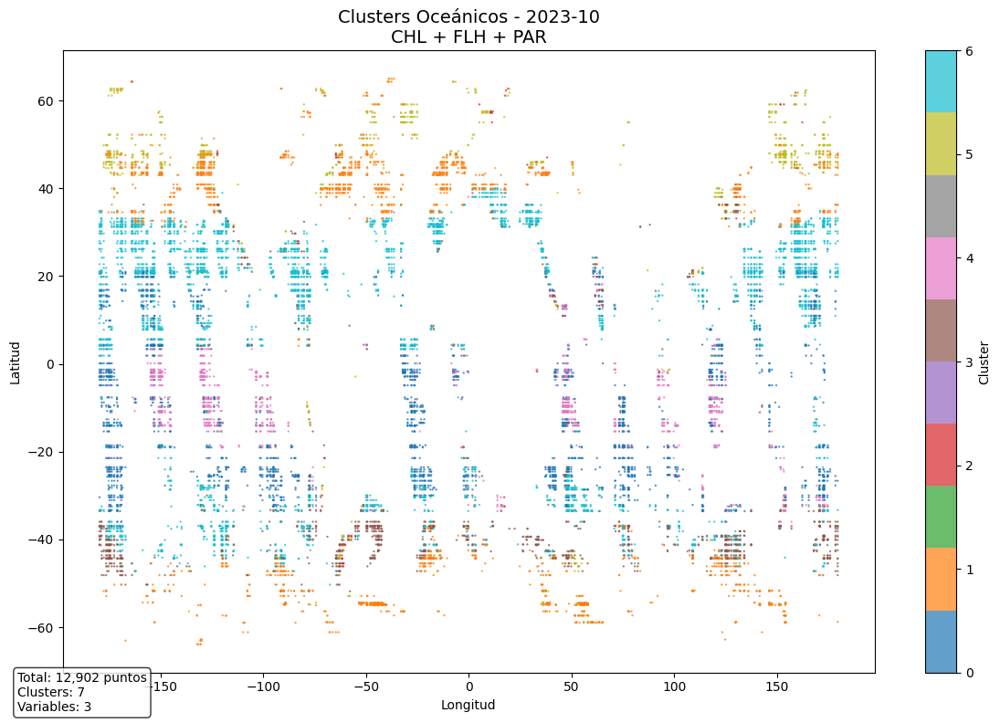


📊 ESTADÍSTICAS - 2023-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 12,902
Clusters encontrados: 7
Cluster 0: 2,630 pts (20.4%)
Cluster 1: 2,276 pts (17.6%)
Cluster 2: 73 pts (0.6%)
Cluster 3: 1,443 pts (11.2%)
Cluster 4: 1,258 pts (9.8%)
Cluster 5: 935 pts (7.2%)
Cluster 6: 4,287 pts (33.2%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_10.csv (12,902 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 12/276 meses

📅 PROCESANDO: 2023-11
📥 Cargando datos para 2023-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2023-11
⚠️  No se pudo cargar datos para 2023-11

📍 Progreso: 12/276 meses

📅 PROCESANDO: 2023-12
📥 Cargando datos para 2023-12...
📁 Encontra

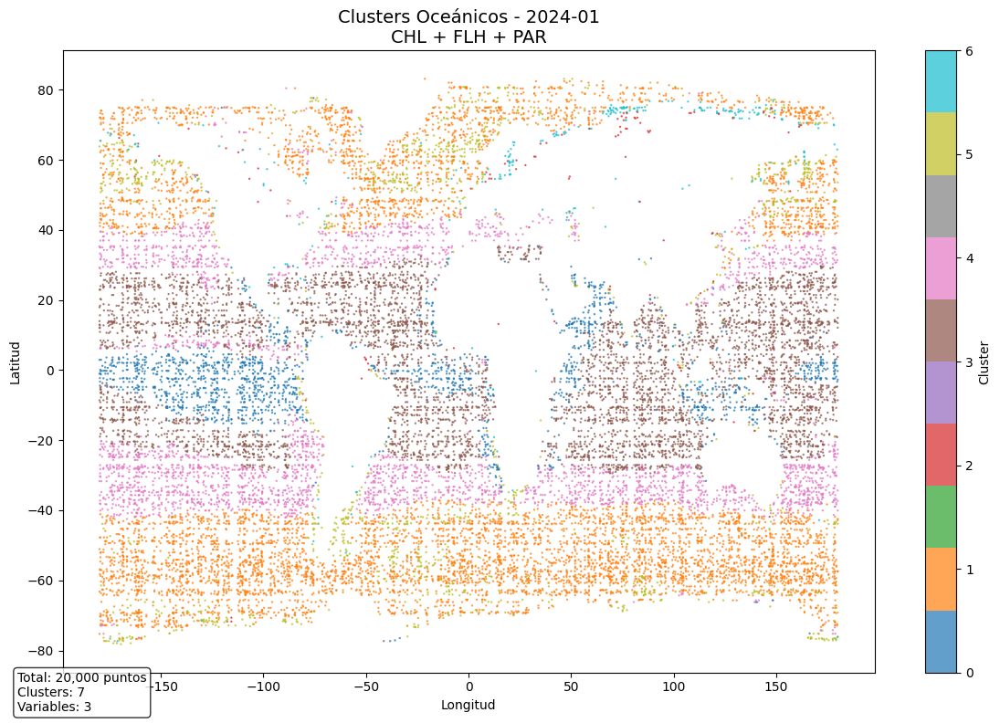


📊 ESTADÍSTICAS - 2024-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 1,759 pts (8.8%)
Cluster 1: 7,314 pts (36.6%)
Cluster 2: 118 pts (0.6%)
Cluster 3: 5,399 pts (27.0%)
Cluster 4: 3,610 pts (18.1%)
Cluster 5: 1,505 pts (7.5%)
Cluster 6: 295 pts (1.5%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-01 (3 variables)

📍 Progreso: 13/276 meses

📅 PROCESANDO: 2024-02
📥 Cargando datos para 2024-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2024-02
⚠️  No se pudo cargar datos para 2024-02
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 13/276 meses

📅 PROCESANDO: 2024-03
📥 Cargando datos para 2024-03...
📁 Encontra

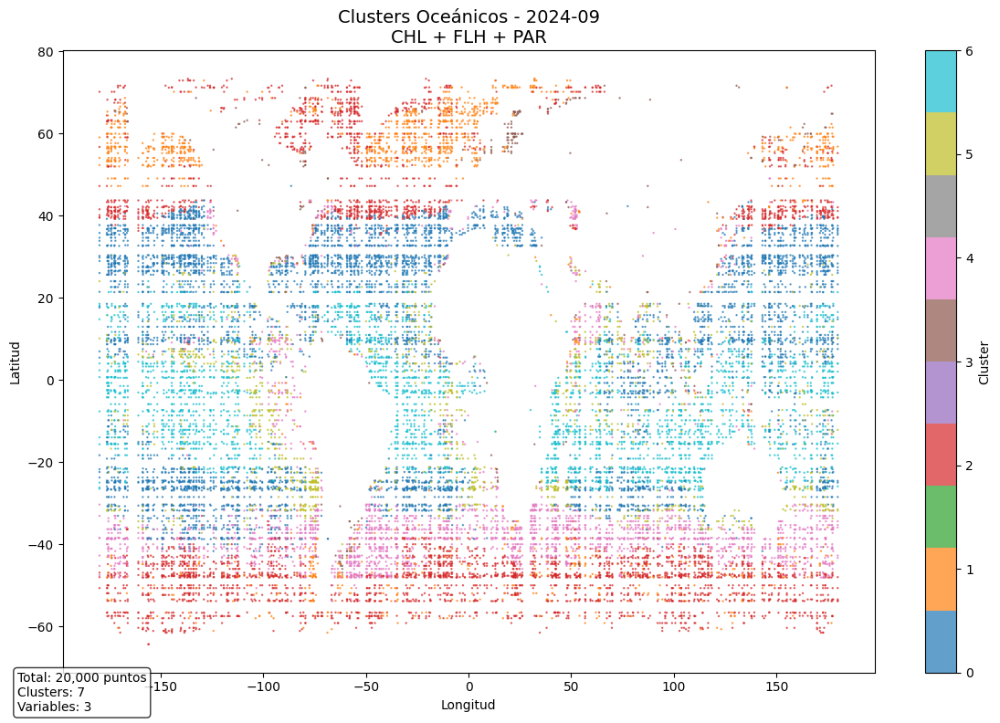


📊 ESTADÍSTICAS - 2024-09
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 6,112 pts (30.6%)
Cluster 1: 1,745 pts (8.7%)
Cluster 2: 4,148 pts (20.7%)
Cluster 3: 318 pts (1.6%)
Cluster 4: 2,832 pts (14.2%)
Cluster 5: 1,642 pts (8.2%)
Cluster 6: 3,203 pts (16.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_09.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-09 (3 variables)

📍 Progreso: 14/276 meses

📅 PROCESANDO: 2024-10
📥 Cargando datos para 2024-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
❌ Variable nflh no encontrada en AQUA_MODIS.20241001_20241031.L3m.MO.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20241005.L3m.DAY.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20241001_20241031.L3m.MO.FLH.ipar.4km.nc
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20

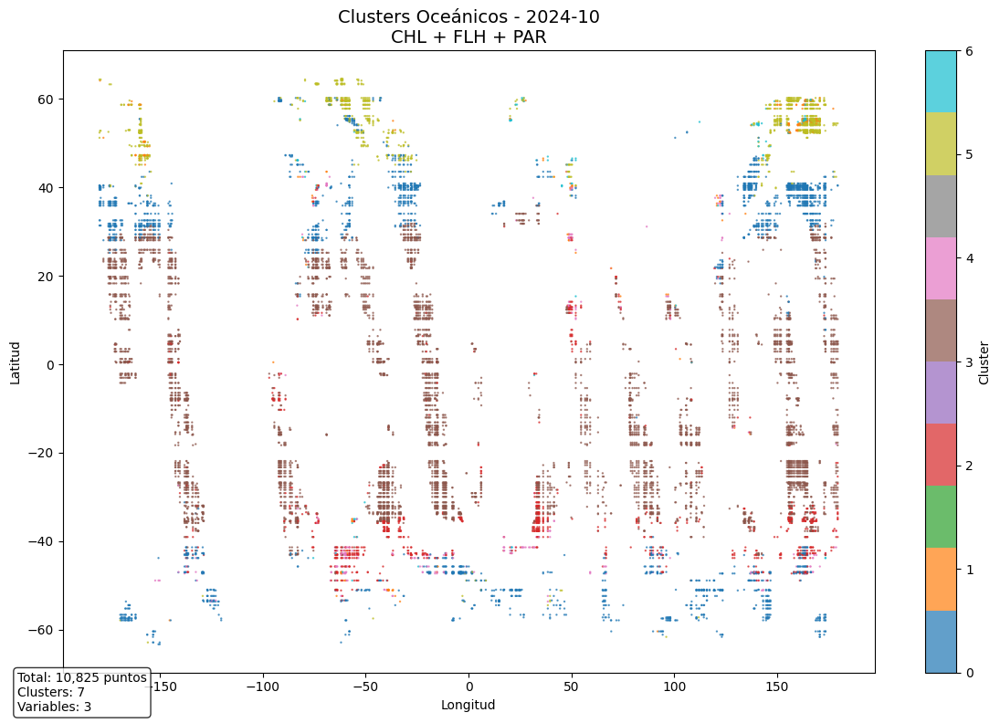


📊 ESTADÍSTICAS - 2024-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 10,825
Clusters encontrados: 7
Cluster 0: 2,526 pts (23.3%)
Cluster 1: 228 pts (2.1%)
Cluster 2: 1,070 pts (9.9%)
Cluster 3: 5,460 pts (50.4%)
Cluster 4: 304 pts (2.8%)
Cluster 5: 1,109 pts (10.2%)
Cluster 6: 128 pts (1.2%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_10.csv (10,825 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 15/276 meses

📅 PROCESANDO: 2024-11
📥 Cargando datos para 2024-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
⚠️  No hay variables disponibles para 2024-11
⚠️  No se pudo cargar datos para 2024-11

📍 Progreso: 15/276 meses

📅 PROCESANDO: 2024-12
📥 Cargando datos para 2024-12...
📁 Encontrado

In [ ]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MiniBatchKMeans
import gc
import warnings
warnings.filterwarnings('ignore')

# Configuración de carpetas
chl_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527"
flh_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_FLH_2022.0-20251004_024829"
par_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_PAR_2022.0-20251004_025127"

# Configuración de parámetros
target_months = list(range(1, 13))  # Todos los meses
target_years = list(range(2003, 2026))  # Todos los años
spatial_frac = 0.5
n_clusters = 7
max_points_per_month = 30000

# Verificar y montar Google Drive
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    print("✅ Google Drive montado correctamente")
except:
    print("⚠️  No se pudo montar Google Drive")

def robust_file_loading(folder, var_name, month, year, spatial_frac=0.5):
    """
    Versión robusta para carga de archivos con manejo de errores mejorado
    """
    datasets = []
    files_processed = 0

    # Verificar que la carpeta existe y es accesible
    if not os.path.exists(folder):
        print(f"❌ Carpeta no encontrada: {folder}")
        return datasets

    try:
        files = os.listdir(folder)
        print(f"📁 Encontrados {len(files)} archivos en {os.path.basename(folder)}")
    except OSError as e:
        print(f"❌ Error accediendo a la carpeta {folder}: {e}")
        return datasets

    for f in files:
        if not f.endswith(".nc"):
            continue

        try:
            # Extraer fecha del nombre del archivo de forma más robusta
            parts = f.split(".")
            if len(parts) < 2:
                continue

            date_str = parts[1]  # '20030101_20220131'
            y = int(date_str[:4])
            m = int(date_str[4:6])

            if y != year or m != month:
                continue

        except (ValueError, IndexError) as e:
            continue

        path = os.path.join(folder, f)

        try:
            # Intentar diferentes motores para abrir el archivo NetCDF
            ds = None
            for engine in ['netcdf4', 'h5netcdf', 'scipy']:
                try:
                    ds = xr.open_dataset(path, engine=engine, chunks={'lat': 50, 'lon': 50})
                    break
                except Exception as engine_error:
                    continue

            if ds is None:
                print(f"❌ No se pudo abrir {f} con ningún motor")
                continue

            if var_name not in ds:
                print(f"❌ Variable {var_name} no encontrada en {f}")
                ds.close()
                continue

            # Verificar coordenadas
            if "lat" not in ds or "lon" not in ds:
                print(f"❌ Coordenadas faltantes en {f}")
                ds.close()
                continue

            lat = ds["lat"].values
            lon = ds["lon"].values

            if len(lat) < 5 or len(lon) < 5:
                print(f"⚠️  Coordenadas insuficientes en {f}")
                ds.close()
                continue

            # Muestreo espacial
            n_lat = max(1, int(len(lat) * spatial_frac))
            n_lon = max(1, int(len(lon) * spatial_frac))

            try:
                lat_idx = np.sort(np.random.choice(len(lat), n_lat, replace=False))
                lon_idx = np.sort(np.random.choice(len(lon), n_lon, replace=False))
            except ValueError as e:
                print(f"❌ Error en muestreo de {f}: {e}")
                ds.close()
                continue

            # Cargar subconjunto de datos
            try:
                sub_ds = ds[[var_name]].isel(lat=lat_idx, lon=lon_idx).load()
                datasets.append(sub_ds)
                files_processed += 1
            except Exception as load_error:
                print(f"❌ Error cargando datos de {f}: {load_error}")
                ds.close()
                continue

            ds.close()

            # Límite de archivos por variable
            if files_processed >= 2:  # Reducido a 2 para mayor estabilidad
                break

        except Exception as e:
            print(f"❌ Error procesando {f}: {e}")
            continue

    return datasets

def load_and_combine_monthly_data_flexible(month, year, spatial_frac=0.5):
    """
    Versión FLEXIBLE que combina las variables disponibles
    """
    print(f"📥 Cargando datos para {year}-{month:02d}...")

    # Cargar datos de cada variable
    chl_datasets = robust_file_loading(chl_folder, "chlor_a", month, year, spatial_frac)
    flh_datasets = robust_file_loading(flh_folder, "nflh", month, year, spatial_frac)
    par_datasets = robust_file_loading(par_folder, "par", month, year, spatial_frac)

    # Verificar qué variables tenemos disponibles
    available_vars = []
    datasets_to_combine = []
    var_names_map = {'chl': 'CHL', 'flh': 'FLH', 'par': 'PAR'}

    if chl_datasets:
        try:
            chl_combined = xr.concat(chl_datasets, dim="time").rename({'chlor_a': 'chl'})
            datasets_to_combine.append(chl_combined)
            available_vars.append("chl")
            print(f"✅ CHL disponible: {chl_combined.dims}")
        except Exception as e:
            print(f"❌ Error combinando CHL: {e}")

    if flh_datasets:
        try:
            flh_combined = xr.concat(flh_datasets, dim="time").rename({'nflh': 'flh'})
            datasets_to_combine.append(flh_combined)
            available_vars.append("flh")
            print(f"✅ FLH disponible: {flh_combined.dims}")
        except Exception as e:
            print(f"❌ Error combinando FLH: {e}")

    if par_datasets:
        try:
            par_combined = xr.concat(par_datasets, dim="time").rename({'par': 'par'})
            datasets_to_combine.append(par_combined)
            available_vars.append("par")
            print(f"✅ PAR disponible: {par_combined.dims}")
        except Exception as e:
            print(f"❌ Error combinando PAR: {e}")

    if not datasets_to_combine:
        print(f"⚠️  No hay variables disponibles para {year}-{month:02d}")
        return None, []

    # Combinar datasets disponibles
    try:
        merged = xr.merge(datasets_to_combine, compat='override')
        print(f"✅ Datos combinados ({len(available_vars)} variables): {merged.dims}")

        # Liberar memoria
        del chl_datasets, flh_datasets, par_datasets
        gc.collect()

        return merged, available_vars

    except Exception as e:
        print(f"❌ Error combinando datos: {e}")
        return None, []

def process_data_for_clustering_flexible(merged_ds, available_vars, max_points=30000):
    """
    Versión FLEXIBLE que procesa las variables disponibles
    """
    if merged_ds is None:
        return None, None, None, []

    try:
        # Stack dimensiones
        stacked = merged_ds.stack(points=("lat", "lon", "time"))

        # Crear máscara válida para las variables disponibles
        valid_mask = None
        for var in available_vars:
            if valid_mask is None:
                valid_mask = ~xr.ufuncs.isnan(stacked[var])
            else:
                valid_mask = valid_mask & ~xr.ufuncs.isnan(stacked[var])

        # Aplicar máscara para mantener solo puntos válidos
        stacked_valid = stacked.where(valid_mask, drop=True)

        if len(stacked_valid.points) == 0:
            print("❌ No hay puntos válidos después del filtrado")
            return None, None, None, available_vars

        # LIMITAR número de puntos para evitar memoria
        n_points = len(stacked_valid.points)
        if n_points > max_points:
            print(f"⚠️  Muchos puntos ({n_points}), muestreando a {max_points}")
            idx = np.random.choice(n_points, max_points, replace=False)
            stacked_valid = stacked_valid.isel(points=idx)

        # Extraer datos de las variables disponibles
        var_values = []
        for var in available_vars:
            var_values.append(stacked_valid[var].values)

        # Extraer coordenadas
        lat_values = stacked_valid["lat"].values
        lon_values = stacked_valid["lon"].values

        # Verificar que todos tengan la misma longitud
        lengths = [len(v) for v in var_values] + [len(lat_values), len(lon_values)]
        if len(set(lengths)) != 1:
            print(f"❌ Error: Dimensiones inconsistentes {lengths}")
            min_length = min(lengths)
            var_values = [v[:min_length] for v in var_values]
            lat_values = lat_values[:min_length]
            lon_values = lon_values[:min_length]
            print(f"✅ Ajustado a longitud común: {min_length}")

        # Crear array de características
        X_clean = np.column_stack(var_values)

        print(f"✅ Datos para clustering: {X_clean.shape} ({len(available_vars)} variables)")
        print(f"✅ Coordenadas: lat {lat_values.shape}, lon {lon_values.shape}")

        # Verificación final de dimensiones
        assert len(X_clean) == len(lat_values) == len(lon_values), \
            f"Dimensiones finales inconsistentes"

        # Liberar memoria del stacked
        del stacked, stacked_valid
        gc.collect()

        return X_clean, lat_values, lon_values, available_vars

    except Exception as e:
        print(f"❌ Error en procesamiento: {e}")
        return None, None, None, available_vars

def perform_clustering_flexible(X_clean, lat_clean, lon_clean, available_vars, n_clusters=7):
    """
    Versión FLEXIBLE del clustering que maneja diferentes números de variables
    """
    if X_clean is None or len(X_clean) == 0:
        return None, None, None

    try:
        # Verificación de dimensiones antes de procesar
        if len(X_clean) != len(lat_clean) or len(X_clean) != len(lon_clean):
            print(f"❌ Dimensiones inconsistentes al inicio de clustering")
            min_len = min(len(X_clean), len(lat_clean), len(lon_clean))
            X_clean = X_clean[:min_len]
            lat_clean = lat_clean[:min_len]
            lon_clean = lon_clean[:min_len]
            print(f"✅ Ajustado a longitud común: {min_len}")

        # Limpiar NaN - aplicar la misma máscara a todos los arrays
        valid_mask = ~np.isnan(X_clean).any(axis=1)

        # Aplicar la misma máscara a todos los arrays
        X_clean_filtered = X_clean[valid_mask]
        lat_clean_filtered = lat_clean[valid_mask]
        lon_clean_filtered = lon_clean[valid_mask]

        if len(X_clean_filtered) == 0:
            print("❌ No hay datos válidos después de limpieza NaN")
            return None, None, None

        print(f"🔍 Datos limpios para clustering: {X_clean_filtered.shape}")

        # Si hay demasiados puntos, muestrear más (aplicar mismo muestreo a todos)
        if len(X_clean_filtered) > 20000:
            print(f"⚠️  Muestreando datos de {len(X_clean_filtered)} a 20000")
            idx = np.random.choice(len(X_clean_filtered), 20000, replace=False)
            X_clean_filtered = X_clean_filtered[idx]
            lat_clean_filtered = lat_clean_filtered[idx]
            lon_clean_filtered = lon_clean_filtered[idx]

        # Escalar variables ambientales
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_clean_filtered)

        # Escalar coordenadas
        lat_scaled = (lat_clean_filtered - lat_clean_filtered.mean()) / lat_clean_filtered.std()
        lon_scaled = (lon_clean_filtered - lon_clean_filtered.mean()) / lon_clean_filtered.std()

        # Combinar con peso reducido para coordenadas
        X_final = np.column_stack([X_scaled, 0.05 * lat_scaled, 0.05 * lon_scaled])

        print(f"📊 Datos finales: {X_final.shape}")

        # MiniBatch KMeans con parámetros optimizados
        kmeans = MiniBatchKMeans(
            n_clusters=n_clusters,
            batch_size=min(1000, len(X_final)),
            random_state=42,
            n_init=3,
            max_iter=100,
            tol=1e-3
        )

        print("🎯 Entrenando MiniBatchKMeans...")
        kmeans.fit(X_final)
        labels = kmeans.labels_

        print(f"✅ Clusters encontrados: {np.unique(labels)}")

        # Devolver labels y las coordenadas filtradas que corresponden
        return labels, lat_clean_filtered, lon_clean_filtered

    except Exception as e:
        print(f"❌ Error en clustering: {e}")
        return None, None, None

def lightweight_visualization_flexible(lat_clean, lon_clean, labels, month, year, available_vars):
    """
    Visualización ligera que muestra las variables utilizadas
    """
    if labels is None:
        print("❌ No hay clusters para visualizar")
        return

    try:
        # Verificar dimensiones antes de visualizar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes en visualización")
            return

        # Crear figura simple
        plt.figure(figsize=(12, 8))

        # Solo el mapa de clusters
        scatter = plt.scatter(lon_clean, lat_clean, c=labels,
                            s=0.5, cmap="tab10", alpha=0.7)

        # Título que muestra las variables utilizadas
        vars_text = " + ".join([v.upper() for v in available_vars])
        plt.title(f'Clusters Oceánicos - {year}-{month:02d}\n{vars_text}', fontsize=14)
        plt.xlabel("Longitud")
        plt.ylabel("Latitud")
        plt.colorbar(scatter, label="Cluster")

        # Estadísticas en texto
        unique_labels, counts = np.unique(labels, return_counts=True)
        stats_text = f"Total: {len(labels):,} puntos\nClusters: {len(unique_labels)}\nVariables: {len(available_vars)}"
        plt.figtext(0.02, 0.02, stats_text, fontsize=10,
                   bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

        plt.tight_layout()
        plt.show()

        # Estadísticas en consola
        print(f"\n📊 ESTADÍSTICAS - {year}-{month:02d}")
        print("=" * 50)
        print(f"Variables utilizadas: {available_vars}")
        print(f"Total puntos: {len(labels):,}")
        print(f"Clusters encontrados: {len(unique_labels)}")
        for cluster_id, count in zip(unique_labels, counts):
            percentage = count/len(labels)*100
            print(f"Cluster {cluster_id}: {count:,} pts ({percentage:.1f}%)")

    except Exception as e:
        print(f"❌ Error en visualización: {e}")

def save_results_optimized(lat_clean, lon_clean, labels, month, year, available_vars,
                          base_path="/content/drive/MyDrive/NASA Space Apps/results2"):
    """
    Guardado optimizado con información de variables utilizadas
    """
    if labels is None:
        print("❌ No hay resultados para guardar")
        return None

    try:
        # Verificar dimensiones antes de guardar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes al guardar")
            return None

        os.makedirs(base_path, exist_ok=True)

        # Si hay muchos datos, guardar muestreado
        if len(labels) > 50000:
            print(f"⚠️  Muchos datos ({len(labels)}), guardando muestra de 50k")
            idx = np.random.choice(len(labels), 50000, replace=False)
            results_df = pd.DataFrame({
                "lat": lat_clean[idx],
                "lon": lon_clean[idx],
                "cluster": labels[idx],
                "month": month,
                "year": year
            })
        else:
            results_df = pd.DataFrame({
                "lat": lat_clean,
                "lon": lon_clean,
                "cluster": labels,
                "month": month,
                "year": year
            })

        # Agregar información de variables utilizadas
        results_df['variables_used'] = ",".join(available_vars)
        results_df['n_variables'] = len(available_vars)

        filename = f"clusters_{year}_{month:02d}.csv"
        filepath = os.path.join(base_path, filename)

        results_df.to_csv(filepath, index=False)
        print(f"💾 Guardado: {filepath} ({len(results_df):,} registros, {len(available_vars)} variables)")

        return filepath

    except Exception as e:
        print(f"❌ Error guardando: {e}")
        return None

def aggressive_memory_cleanup():
    """
    Limpieza agresiva de memoria
    """
    gc.collect()
    for i in range(3):
        gc.collect()
    print("🧹 Memoria liberada")

def process_single_month_flexible(year, month):
    """
    Procesa un solo mes de forma FLEXIBLE con las variables disponibles
    """
    print(f"\n{'='*50}")
    print(f"📅 PROCESANDO: {year}-{month:02d}")
    print(f"{'='*50}")

    try:
        # 1. Cargar datos FLEXIBLE (con variables disponibles)
        merged_ds, available_vars = load_and_combine_monthly_data_flexible(month, year, spatial_frac)
        if merged_ds is None:
            print(f"⚠️  No se pudo cargar datos para {year}-{month:02d}")
            return False

        # 2. Procesar para clustering FLEXIBLE
        X_clean, lat_clean, lon_clean, available_vars = process_data_for_clustering_flexible(
            merged_ds, available_vars, max_points_per_month)

        # Liberar dataset combinado
        del merged_ds
        aggressive_memory_cleanup()

        if X_clean is None:
            print(f"⚠️  No hay datos válidos para clustering en {year}-{month:02d}")
            return False

        # 3. Clustering FLEXIBLE
        clustering_result = perform_clustering_flexible(X_clean, lat_clean, lon_clean, available_vars, n_clusters)

        # Liberar arrays grandes
        del X_clean, lat_clean, lon_clean
        aggressive_memory_cleanup()

        if clustering_result is None:
            print(f"⚠️  Clustering falló para {year}-{month:02d}")
            return False

        labels, lat_filtered, lon_filtered = clustering_result

        # 4. Visualización ligera FLEXIBLE
        lightweight_visualization_flexible(lat_filtered, lon_filtered, labels, month, year, available_vars)

        # 5. Guardar resultados
        save_results_optimized(lat_filtered, lon_filtered, labels, month, year, available_vars)

        # 6. Limpiar todo
        del labels, lat_filtered, lon_filtered
        aggressive_memory_cleanup()

        print(f"✅ COMPLETADO: {year}-{month:02d} ({len(available_vars)} variables)")
        return True

    except Exception as e:
        print(f"❌ Error en {year}-{month:02d}: {str(e)}")
        import traceback
        traceback.print_exc()
        aggressive_memory_cleanup()
        return False

# PROGRAMA PRINCIPAL FLEXIBLE
def main_flexible():
    print("🚀 ANÁLISIS FLEXIBLE CON MINIBATCHKMEANS")
    print("=" * 60)
    print(f"📅 Años: {len(target_years)} | Meses: {len(target_months)}")
    print(f"📊 Muestreo espacial: {spatial_frac}")
    print(f"🔢 Clusters: {n_clusters}")
    print(f"📈 Límite puntos/mes: {max_points_per_month:,}")
    print(f"💾 Destino: /content/drive/MyDrive/NASA Space Apps/results2")
    print("=" * 60)

    successful_months = 0
    total_months = len(target_years) * len(target_months)

    for i, year in enumerate(target_years):
        print(f"\n📅 PROCESANDO AÑO {year} ({i+1}/{len(target_years)})")

        for j, month in enumerate(target_months):
            print(f"\n📍 Progreso: {successful_months}/{total_months} meses")

            if process_single_month_flexible(year, month):
                successful_months += 1

            # Pausa cada 2 meses para evitar sobrecarga
            if (j + 1) % 2 == 0:
                print("⏸️  Pausa para estabilizar memoria...")
                aggressive_memory_cleanup()

    print(f"\n🎉 ANÁLISIS COMPLETADO!")
    print(f"✅ Meses exitosos: {successful_months}/{total_months}")
    print(f"💾 Resultados guardados en: /content/drive/MyDrive/NASA Space Apps/results2")
    print("=" * 60)

# Ejecutar versión flexible
if __name__ == "__main__":
    main_flexible()

## Fix

Mounted at /content/drive
✅ Google Drive montado correctamente
🚀 ANÁLISIS MEJORADO CON MINIBATCHKMEANS
📅 Años: 23 | Meses: 12
📊 Muestreo espacial: 0.5
🔢 Clusters: 7
📈 Límite puntos/mes: 30,000
💾 Destino: /content/drive/MyDrive/NASA Space Apps/results2

📅 PROCESANDO AÑO 2003 (1/23)

📍 Progreso: 0/276 meses

📅 PROCESANDO: 2003-01
📥 Cargando datos para 2003-01...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-01: 8


Exception ignored in: <function CachingFileManager.__del__ at 0x7e1c04c90e00>
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/xarray/backends/file_manager.py", line 258, in __del__
    self.close(needs_lock=False)
  File "/usr/local/lib/python3.12/dist-packages/xarray/backends/file_manager.py", line 242, in close
    file.close()
  File "/usr/local/lib/python3.12/dist-packages/h5netcdf/core.py", line 1708, in close
    self._h5file.close()
  File "/usr/local/lib/python3.12/dist-packages/h5py/_hl/files.py", line 630, in close
    self.id._close_open_objects(h5f.OBJ_LOCAL | h5f.OBJ_FILE)
  File "h5py/_objects.pyx", line 56, in h5py._objects.with_phil.wrapper
  File "h5py/_objects.pyx", line 57, in h5py._objects.with_phil.wrapper
  File "h5py/h5f.pyx", line 355, in h5py.h5f.FileID._close_open_objects
RuntimeError: Can't decrement id ref count (unable to close file, errno = 107, error message = 'Transport endpoint is not connected')


✅ Cargado AQUA_MODIS.20030101_20220131.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030101_20230131.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2003-01: 16
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.9km.nc
❌ Variable nflh no encontrada en AQUA_MODIS.20030101_20220131.L3m.MC.FLH.ipar.4km.nc
✅ Cargado AQUA_MODIS.20030101_20220131.L3m.MC.FLH.nflh.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030101_20220131.L3m.MC.FLH.nflh.4km.nc (2160x4320 puntos)
📦 Límite alcanzado: 2 archivos cargados para nflh
📊 Total datasets cargados para nflh: 2
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2003-01: 8
✅ Cargado AQUA_MODIS.20030101_20220131.L3m.MC.PAR.par.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030101_20230131.L3m.MC

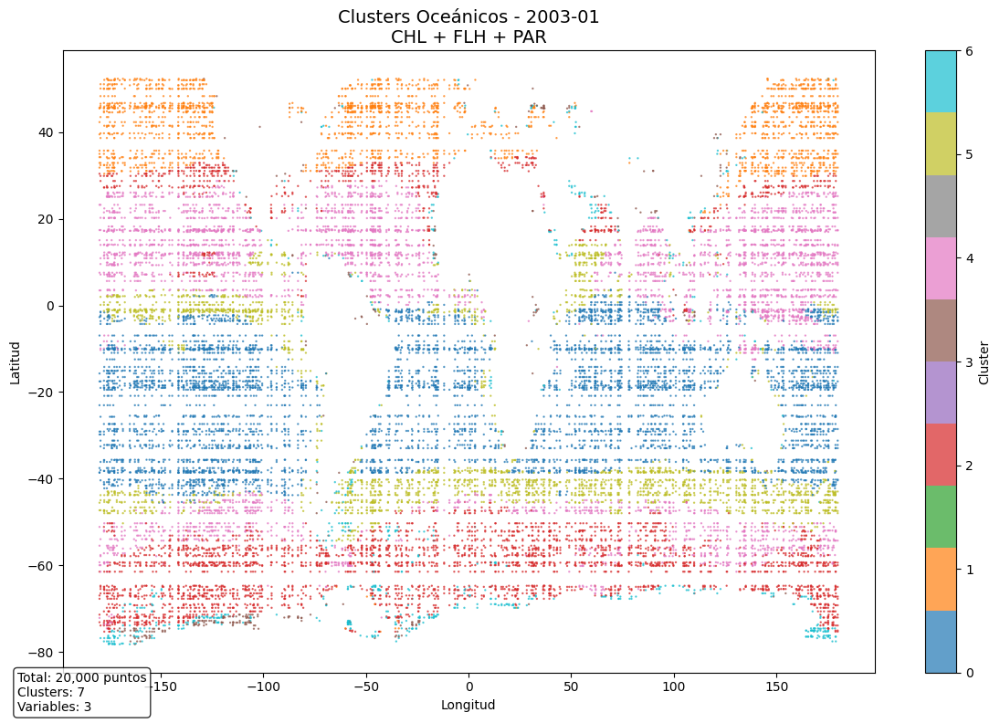


📊 ESTADÍSTICAS - 2003-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,601 pts (28.0%)
Cluster 1: 2,228 pts (11.1%)
Cluster 2: 3,793 pts (19.0%)
Cluster 3: 305 pts (1.5%)
Cluster 4: 4,618 pts (23.1%)
Cluster 5: 2,708 pts (13.5%)
Cluster 6: 747 pts (3.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-01 (3 variables)

📍 Progreso: 1/276 meses

📅 PROCESANDO: 2003-02
📥 Cargando datos para 2003-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-02: 10
✅ Cargado AQUA_MODIS.20030201_20220228.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030201_20220228.L3m.MC.CHL.chlor_a.4km.nc (2160x4320 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos p

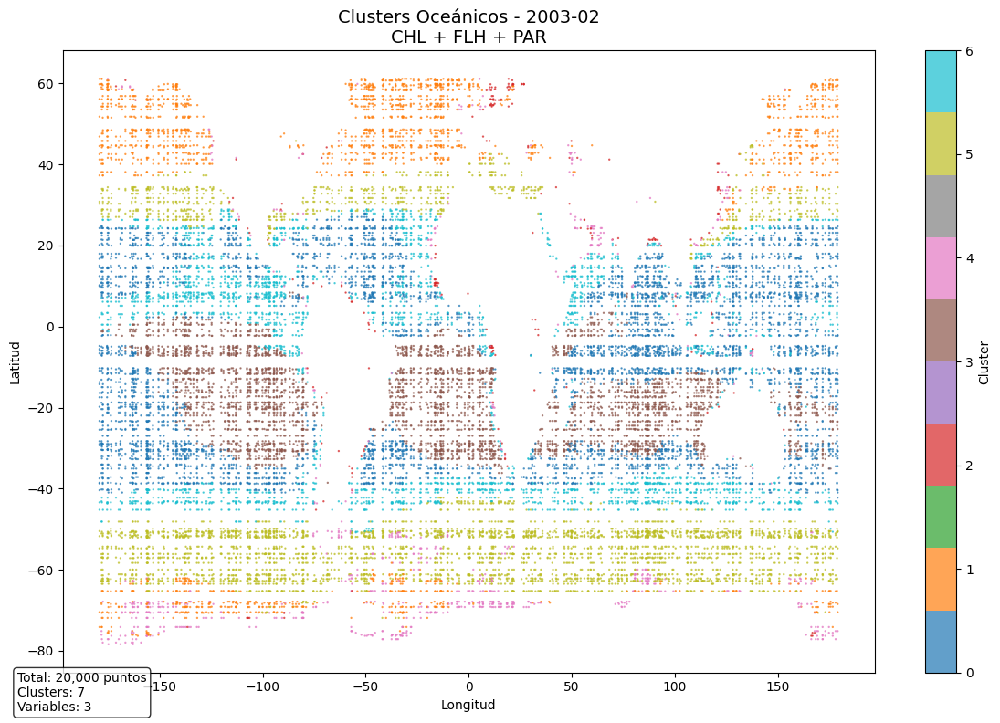


📊 ESTADÍSTICAS - 2003-02
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,627 pts (28.1%)
Cluster 1: 2,269 pts (11.3%)
Cluster 2: 235 pts (1.2%)
Cluster 3: 3,799 pts (19.0%)
Cluster 4: 837 pts (4.2%)
Cluster 5: 4,153 pts (20.8%)
Cluster 6: 3,080 pts (15.4%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_02.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-02 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 2/276 meses

📅 PROCESANDO: 2003-03
📥 Cargando datos para 2003-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-03: 16
✅ Cargado AQUA_MODIS.20030301_20220331.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030301_20220331.L3m.MC.CHL.chlor_a.4km.nc (2160x4320 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archi

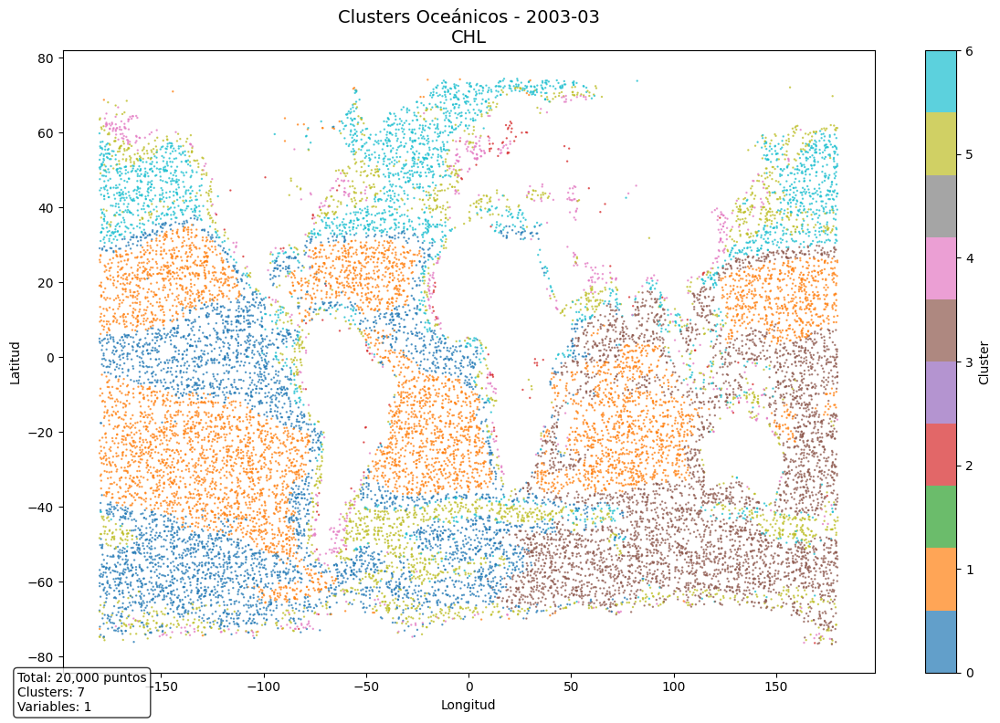


📊 ESTADÍSTICAS - 2003-03
Variables utilizadas: ['chl']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 4,306 pts (21.5%)
Cluster 1: 5,872 pts (29.4%)
Cluster 2: 118 pts (0.6%)
Cluster 3: 3,871 pts (19.4%)
Cluster 4: 686 pts (3.4%)
Cluster 5: 2,498 pts (12.5%)
Cluster 6: 2,649 pts (13.2%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_03.csv (20,000 registros, 1 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-03 (1 variables)

📍 Progreso: 3/276 meses

📅 PROCESANDO: 2003-04
📥 Cargando datos para 2003-04...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-04: 8
✅ Cargado AQUA_MODIS.20030401_20220430.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030401_20230430.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2003-04: 16

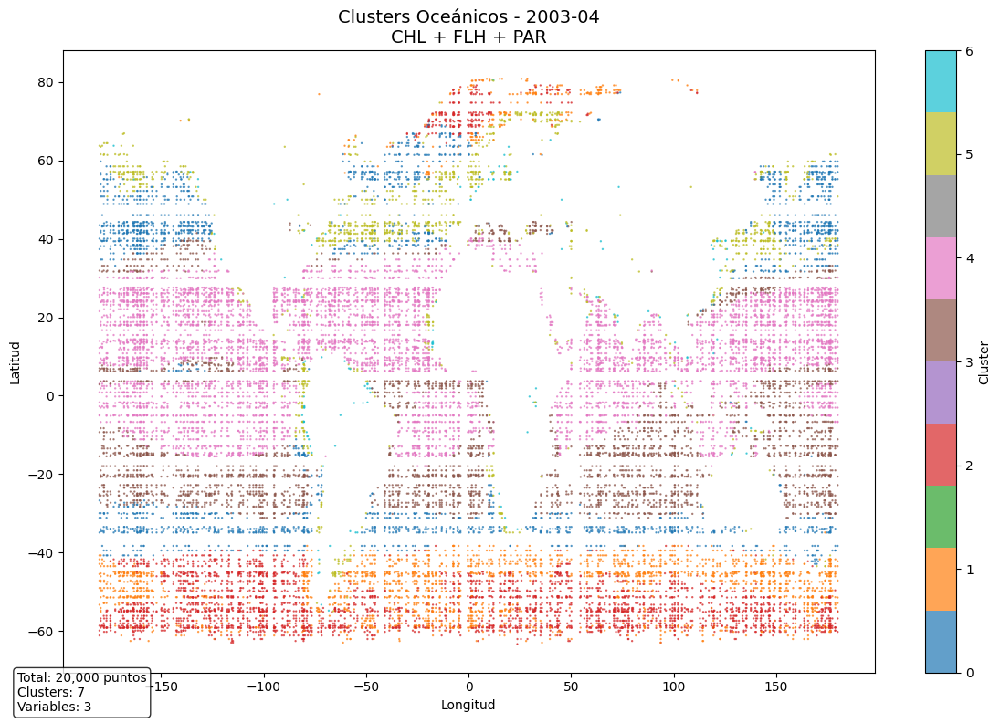


📊 ESTADÍSTICAS - 2003-04
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 2,484 pts (12.4%)
Cluster 1: 2,403 pts (12.0%)
Cluster 2: 3,322 pts (16.6%)
Cluster 3: 3,578 pts (17.9%)
Cluster 4: 6,622 pts (33.1%)
Cluster 5: 1,445 pts (7.2%)
Cluster 6: 146 pts (0.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_04.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-04 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 4/276 meses

📅 PROCESANDO: 2003-05
📥 Cargando datos para 2003-05...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-05: 8
✅ Cargado AQUA_MODIS.20030501_20220531.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030501_20230531.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 arch

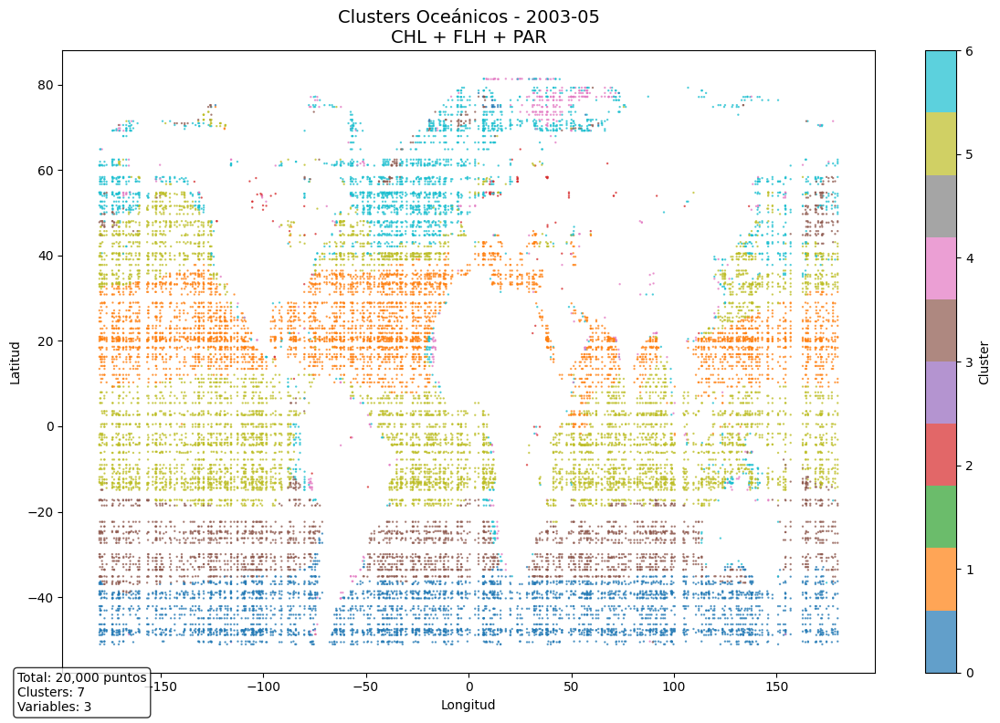


📊 ESTADÍSTICAS - 2003-05
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 3,566 pts (17.8%)
Cluster 1: 4,487 pts (22.4%)
Cluster 2: 90 pts (0.4%)
Cluster 3: 2,655 pts (13.3%)
Cluster 4: 443 pts (2.2%)
Cluster 5: 6,309 pts (31.5%)
Cluster 6: 2,450 pts (12.2%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_05.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-05 (3 variables)

📍 Progreso: 5/276 meses

📅 PROCESANDO: 2003-06
📥 Cargando datos para 2003-06...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-06: 8
✅ Cargado AQUA_MODIS.20030601_20220630.L3m.MC.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20030601_20220630.L3m.MC.CHL.chlor_a.4km.nc (2160x4320 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos par

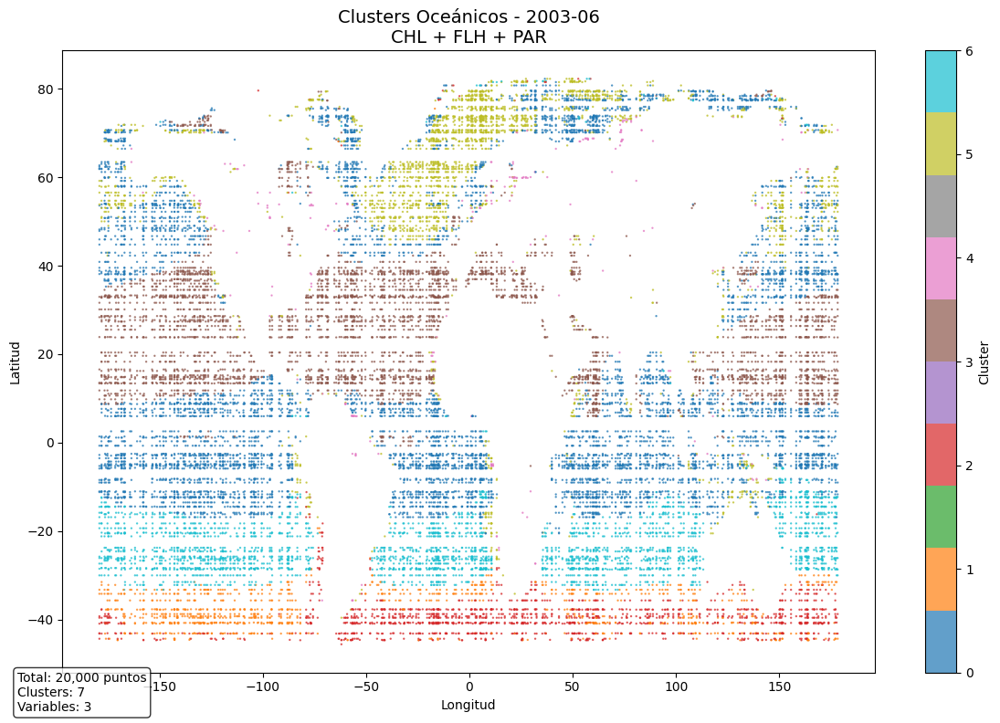


📊 ESTADÍSTICAS - 2003-06
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 7,505 pts (37.5%)
Cluster 1: 1,036 pts (5.2%)
Cluster 2: 1,433 pts (7.2%)
Cluster 3: 4,249 pts (21.2%)
Cluster 4: 235 pts (1.2%)
Cluster 5: 2,642 pts (13.2%)
Cluster 6: 2,900 pts (14.5%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2003_06.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2003-06 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 6/276 meses

📅 PROCESANDO: 2003-07
📥 Cargando datos para 2003-07...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2003-07: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2003-07: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2003-07: 0
📊 Total dataset

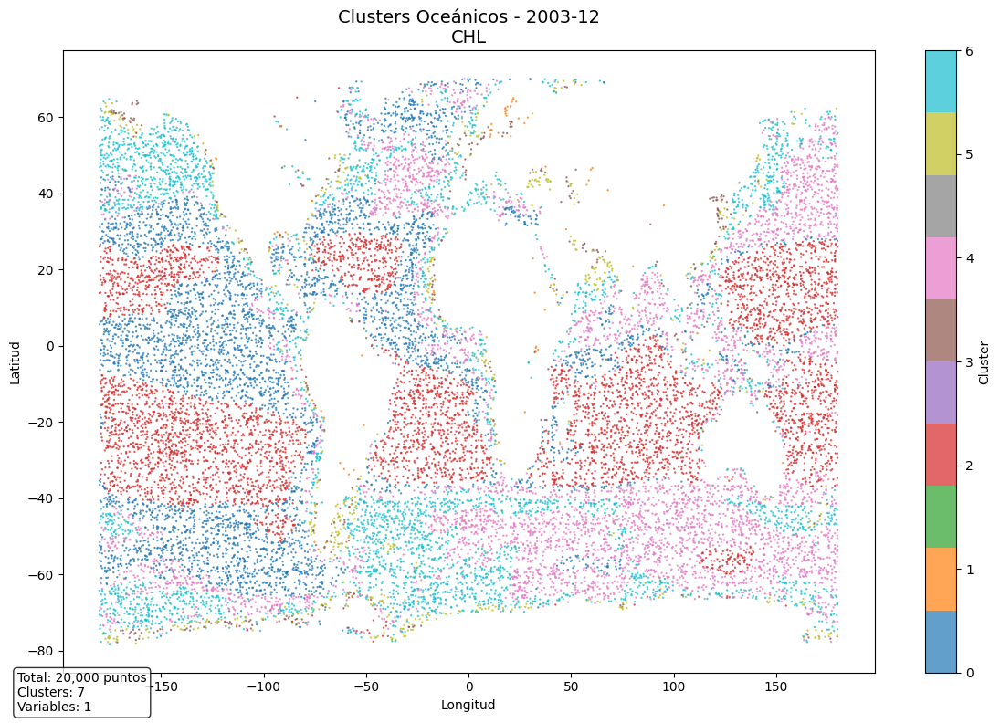

Streaming output truncated to the last 5000 lines.

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2004-03
📥 Cargando datos para 2004-03...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2004-03: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2004-03: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2004-03: 0
📊 Total datasets cargados para par: 0
⚠️  CHL no disponible
⚠️  FLH no disponible
⚠️  PAR no disponible
❌ No hay NINGUNA variable disponible para 2004-03
❌ No se pudieron cargar datos para 2004-03
⏭️  Saltando 2004-03 debido a errores

📍 Progreso: 7/276 meses

📅 PROCESANDO: 2004-04
📥 Cargando datos para 2004-04...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2004-04: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022

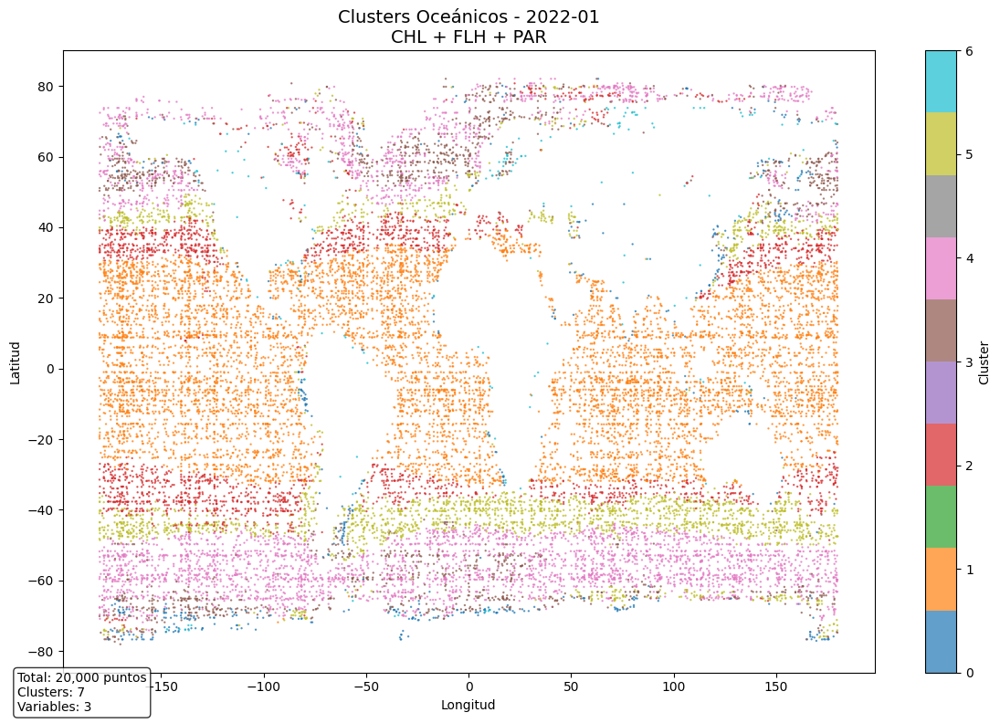


📊 ESTADÍSTICAS - 2022-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 592 pts (3.0%)
Cluster 1: 7,998 pts (40.0%)
Cluster 2: 2,613 pts (13.1%)
Cluster 3: 1,737 pts (8.7%)
Cluster 4: 4,199 pts (21.0%)
Cluster 5: 2,689 pts (13.4%)
Cluster 6: 172 pts (0.9%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2022_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2022-01 (3 variables)

📍 Progreso: 8/276 meses

📅 PROCESANDO: 2022-02
📥 Cargando datos para 2022-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2022-02: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2022-02: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2022-02: 0
📊 Total datasets cargados para par: 0
⚠️  CHL no disponible
⚠️  FLH no dis

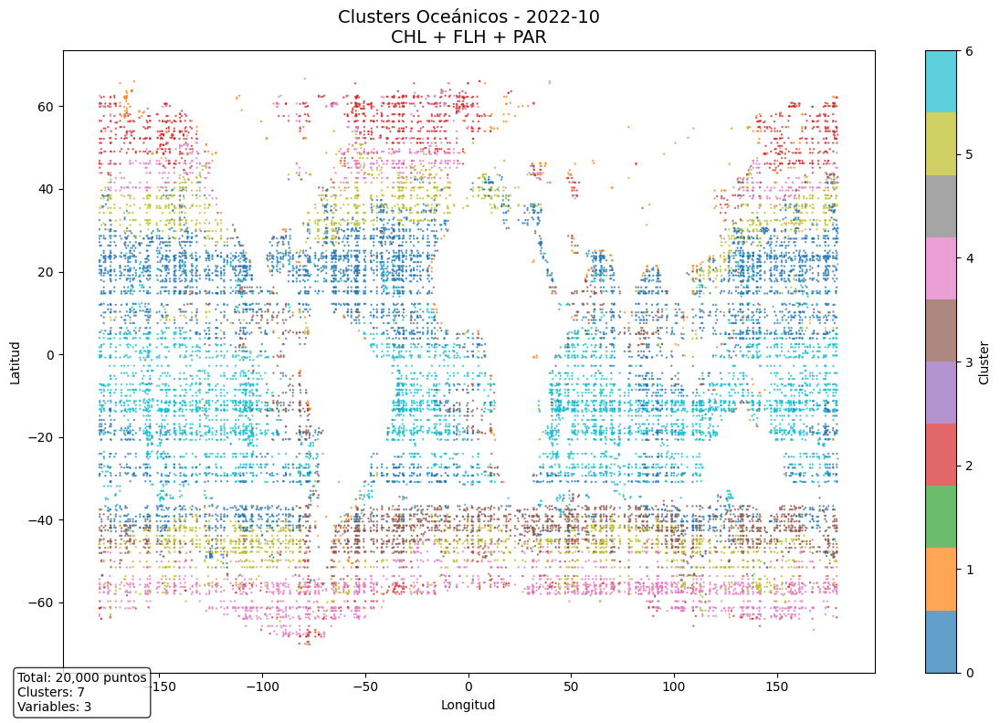


📊 ESTADÍSTICAS - 2022-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 5,592 pts (28.0%)
Cluster 1: 381 pts (1.9%)
Cluster 2: 1,334 pts (6.7%)
Cluster 3: 2,949 pts (14.7%)
Cluster 4: 2,351 pts (11.8%)
Cluster 5: 2,600 pts (13.0%)
Cluster 6: 4,793 pts (24.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2022_10.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2022-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 9/276 meses

📅 PROCESANDO: 2022-11
📥 Cargando datos para 2022-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2022-11: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2022-11: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2022-11: 0
📊 Total datase

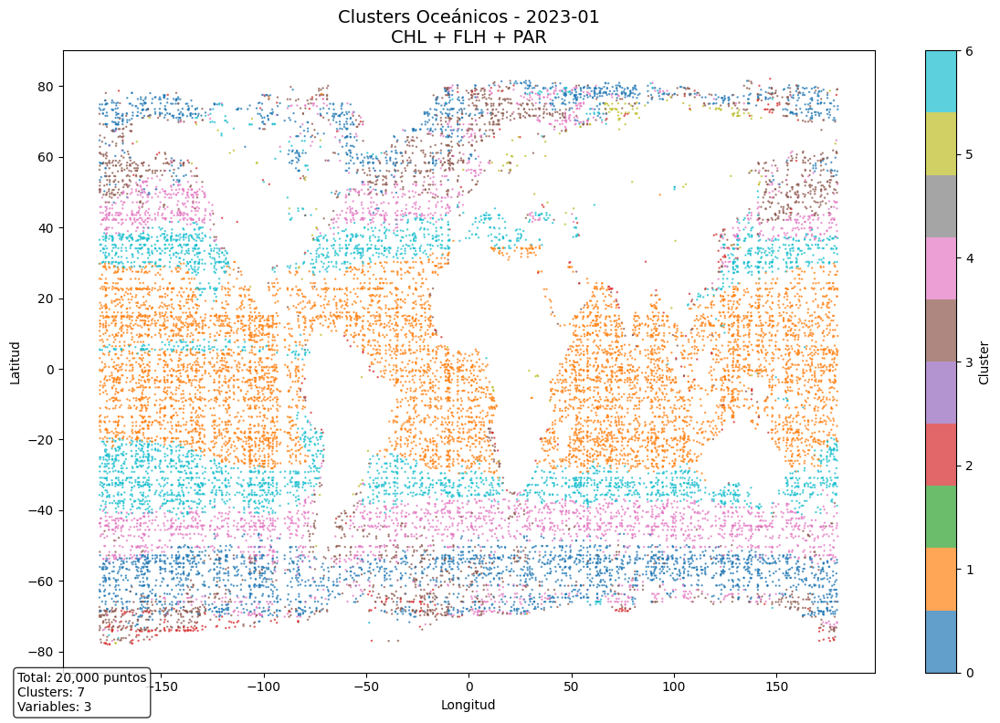


📊 ESTADÍSTICAS - 2023-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 3,390 pts (17.0%)
Cluster 1: 7,329 pts (36.6%)
Cluster 2: 317 pts (1.6%)
Cluster 3: 2,176 pts (10.9%)
Cluster 4: 3,042 pts (15.2%)
Cluster 5: 155 pts (0.8%)
Cluster 6: 3,591 pts (18.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-01 (3 variables)

📍 Progreso: 10/276 meses

📅 PROCESANDO: 2023-02
📥 Cargando datos para 2023-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2023-02: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2023-02: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2023-02: 0
📊 Total datasets cargados para par: 0
⚠️  CHL no disponible
⚠️  FLH no d

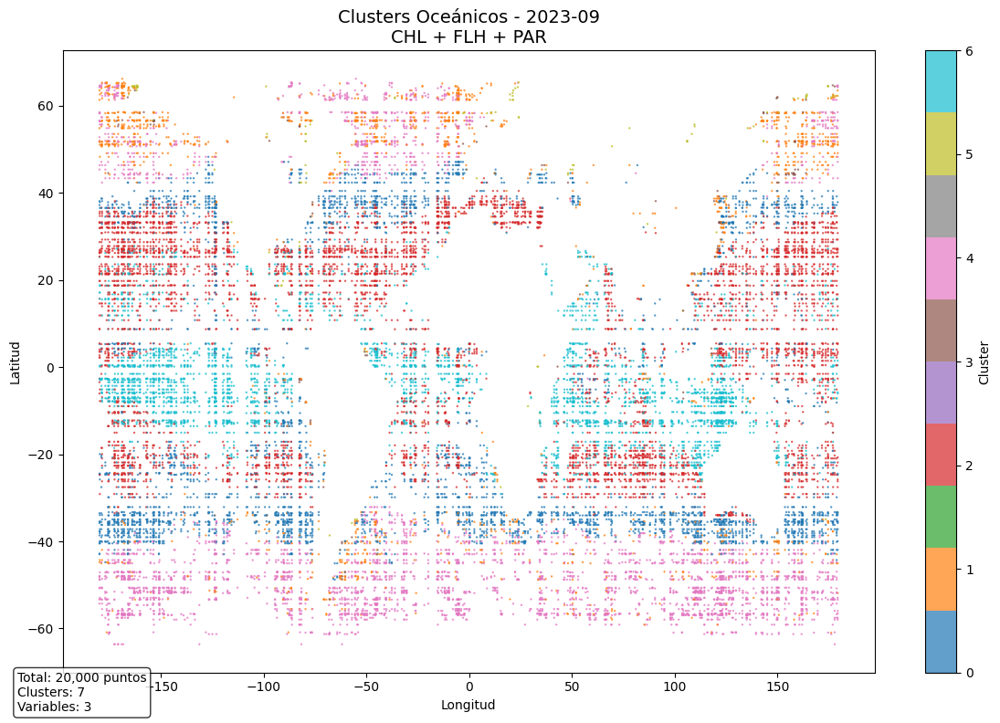


📊 ESTADÍSTICAS - 2023-09
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 4,191 pts (21.0%)
Cluster 1: 1,714 pts (8.6%)
Cluster 2: 5,963 pts (29.8%)
Cluster 3: 135 pts (0.7%)
Cluster 4: 4,270 pts (21.3%)
Cluster 5: 124 pts (0.6%)
Cluster 6: 3,603 pts (18.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_09.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-09 (3 variables)

📍 Progreso: 11/276 meses

📅 PROCESANDO: 2023-10
📥 Cargando datos para 2023-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2023-10: 4
✅ Cargado AQUA_MODIS.20231005.L3m.DAY.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20231001_20231031.L3m.MO.CHL.chlor_a.9km.nc (1080x2160 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2023-

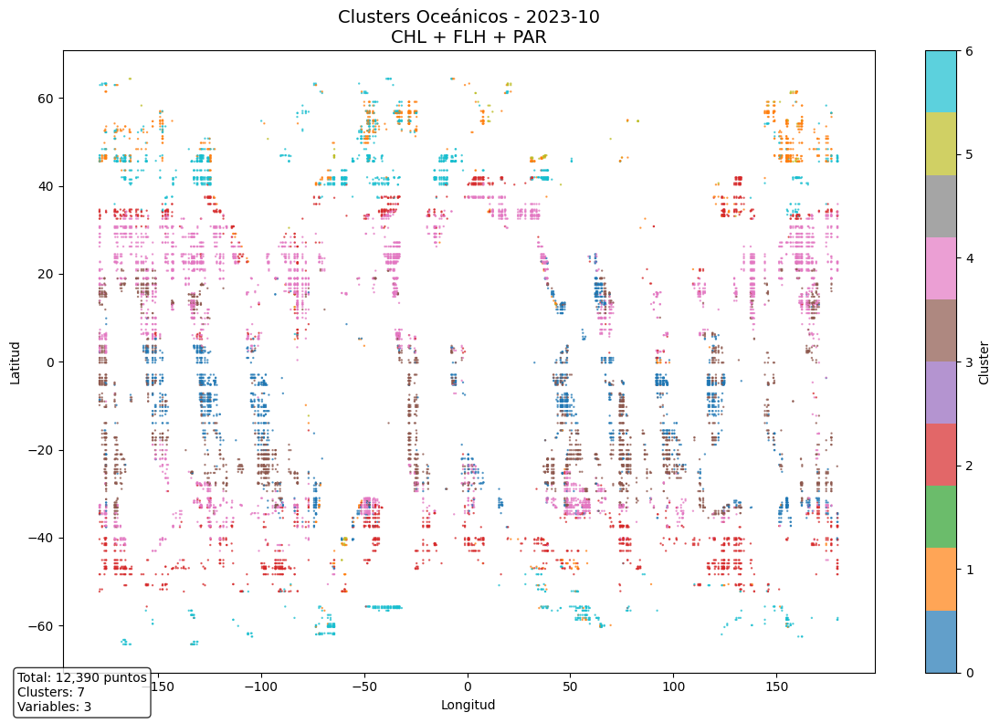


📊 ESTADÍSTICAS - 2023-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 12,390
Clusters encontrados: 7
Cluster 0: 1,897 pts (15.3%)
Cluster 1: 875 pts (7.1%)
Cluster 2: 1,808 pts (14.6%)
Cluster 3: 2,661 pts (21.5%)
Cluster 4: 3,691 pts (29.8%)
Cluster 5: 96 pts (0.8%)
Cluster 6: 1,362 pts (11.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2023_10.csv (12,390 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2023-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 12/276 meses

📅 PROCESANDO: 2023-11
📥 Cargando datos para 2023-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2023-11: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2023-11: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2023-11: 0
📊 Total datasets

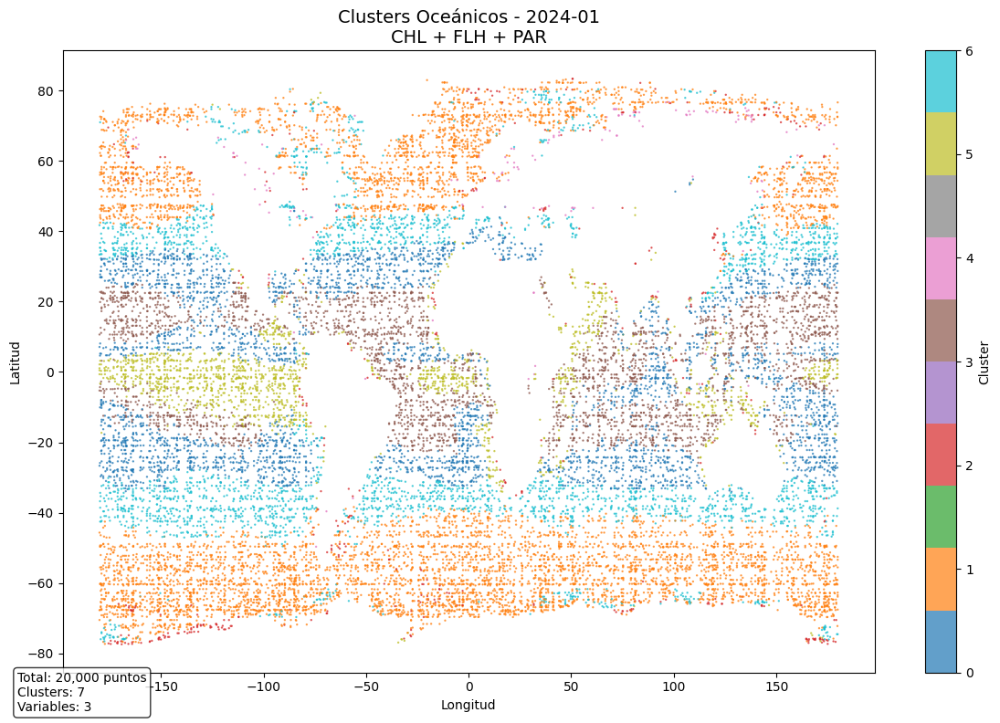


📊 ESTADÍSTICAS - 2024-01
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 3,943 pts (19.7%)
Cluster 1: 7,441 pts (37.2%)
Cluster 2: 456 pts (2.3%)
Cluster 3: 2,996 pts (15.0%)
Cluster 4: 156 pts (0.8%)
Cluster 5: 1,788 pts (8.9%)
Cluster 6: 3,220 pts (16.1%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_01.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-01 (3 variables)

📍 Progreso: 13/276 meses

📅 PROCESANDO: 2024-02
📥 Cargando datos para 2024-02...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2024-02: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2024-02: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2024-02: 0
📊 Total datasets cargados para par: 0
⚠️  CHL no disponible
⚠️  FLH no di

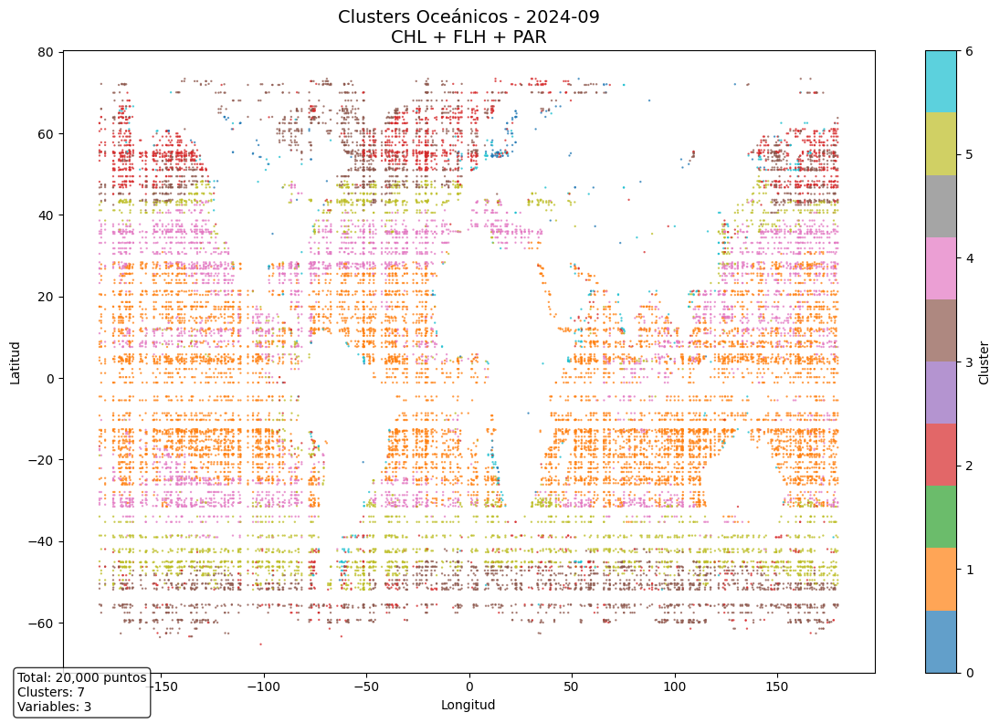


📊 ESTADÍSTICAS - 2024-09
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 20,000
Clusters encontrados: 7
Cluster 0: 139 pts (0.7%)
Cluster 1: 7,572 pts (37.9%)
Cluster 2: 2,023 pts (10.1%)
Cluster 3: 3,233 pts (16.2%)
Cluster 4: 3,925 pts (19.6%)
Cluster 5: 2,761 pts (13.8%)
Cluster 6: 347 pts (1.7%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_09.csv (20,000 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-09 (3 variables)

📍 Progreso: 14/276 meses

📅 PROCESANDO: 2024-10
📥 Cargando datos para 2024-10...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2024-10: 4
✅ Cargado AQUA_MODIS.20241005.L3m.DAY.CHL.chlor_a.9km.nc (1080x2160 puntos)
✅ Cargado AQUA_MODIS.20241001_20241031.L3m.MO.CHL.chlor_a.9km.nc (1080x2160 puntos)
📦 Límite alcanzado: 2 archivos cargados para chlor_a
📊 Total datasets cargados para chlor_a: 2
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2024

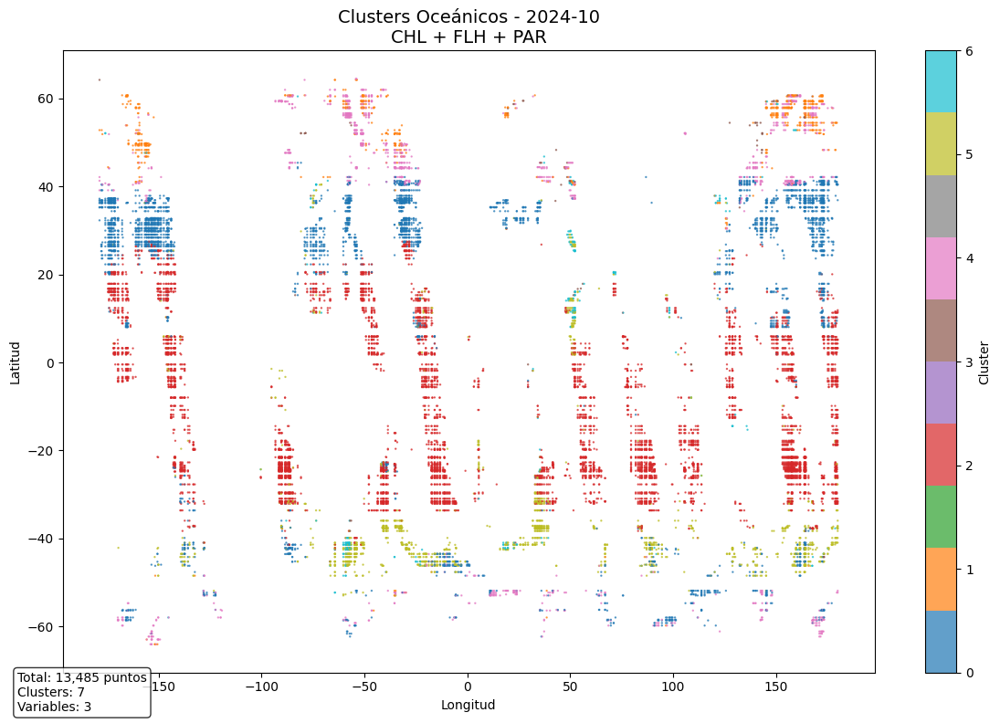


📊 ESTADÍSTICAS - 2024-10
Variables utilizadas: ['chl', 'flh', 'par']
Total puntos: 13,485
Clusters encontrados: 7
Cluster 0: 3,781 pts (28.0%)
Cluster 1: 609 pts (4.5%)
Cluster 2: 5,998 pts (44.5%)
Cluster 3: 87 pts (0.6%)
Cluster 4: 1,166 pts (8.6%)
Cluster 5: 1,575 pts (11.7%)
Cluster 6: 269 pts (2.0%)
💾 Guardado: /content/drive/MyDrive/NASA Space Apps/results2/clusters_2024_10.csv (13,485 registros, 3 variables)
🧹 Memoria liberada
✅ COMPLETADO: 2024-10 (3 variables)
⏸️  Pausa para estabilizar memoria...
🧹 Memoria liberada

📍 Progreso: 15/276 meses

📅 PROCESANDO: 2024-11
📥 Cargando datos para 2024-11...
📁 Encontrados 208 archivos en MODISA_L3m_CHL_2022.0-20251004_024527
📅 Archivos para 2024-11: 0
📊 Total datasets cargados para chlor_a: 0
📁 Encontrados 416 archivos en MODISA_L3m_FLH_2022.0-20251004_024829
📅 Archivos para 2024-11: 0
📊 Total datasets cargados para nflh: 0
📁 Encontrados 210 archivos en MODISA_L3m_PAR_2022.0-20251004_025127
📅 Archivos para 2024-11: 0
📊 Total datasets car

In [ ]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import MiniBatchKMeans
import gc
import warnings
warnings.filterwarnings('ignore')

# Configuración de carpetas
chl_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_CHL_2022.0-20251004_024527"
flh_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_FLH_2022.0-20251004_024829"
par_folder = "/content/drive/MyDrive/NASA Space Apps/data/MODISA_L3m_PAR_2022.0-20251004_025127"

# Configuración de parámetros
target_months = list(range(1, 13))  # Todos los meses
target_years = list(range(2003, 2026))  # Todos los años
spatial_frac = 0.5
n_clusters = 7
max_points_per_month = 30000

# Verificar y montar Google Drive
try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    print("✅ Google Drive montado correctamente")
except:
    print("⚠️  No se pudo montar Google Drive")

def robust_file_loading_enhanced(folder, var_name, month, year, spatial_frac=0.5):
    """
    Versión MEJORADA para carga de archivos con mejor manejo de errores
    """
    datasets = []
    files_processed = 0

    # Verificar que la carpeta existe y es accesible
    if not os.path.exists(folder):
        print(f"❌ Carpeta no encontrada: {folder}")
        return datasets

    try:
        files = os.listdir(folder)
        if not files:
            print(f"📁 Carpeta vacía: {os.path.basename(folder)}")
            return datasets
        print(f"📁 Encontrados {len(files)} archivos en {os.path.basename(folder)}")
    except OSError as e:
        print(f"❌ Error accediendo a la carpeta {folder}: {e}")
        return datasets

    # Filtrar archivos por fecha ANTES de intentar abrirlos
    valid_files = []
    for f in files:
        if not f.endswith(".nc"):
            continue
        try:
            parts = f.split(".")
            if len(parts) < 2:
                continue

            date_str = parts[1]  # '20030101_20220131'
            y = int(date_str[:4])
            m = int(date_str[4:6])

            if y == year and m == month:
                valid_files.append(f)

        except (ValueError, IndexError):
            continue

    print(f"📅 Archivos para {year}-{month:02d}: {len(valid_files)}")

    for f in valid_files:
        path = os.path.join(folder, f)

        try:
            # Intentar diferentes motores para abrir el archivo NetCDF
            ds = None
            engine_errors = []
            for engine in ['netcdf4', 'h5netcdf', 'scipy']:
                try:
                    ds = xr.open_dataset(path, engine=engine, chunks={'lat': 50, 'lon': 50})
                    break
                except Exception as engine_error:
                    engine_errors.append(f"{engine}: {str(engine_error)[:100]}")
                    continue

            if ds is None:
                print(f"❌ No se pudo abrir {f} con ningún motor: {engine_errors}")
                continue

            if var_name not in ds:
                print(f"❌ Variable {var_name} no encontrada en {f}")
                ds.close()
                continue

            # Verificar coordenadas
            if "lat" not in ds or "lon" not in ds:
                print(f"❌ Coordenadas faltantes en {f}")
                ds.close()
                continue

            lat = ds["lat"].values
            lon = ds["lon"].values

            if len(lat) < 3 or len(lon) < 3:  # Reducido el mínimo requerido
                print(f"⚠️  Coordenadas insuficientes en {f} ({len(lat)}x{len(lon)})")
                ds.close()
                continue

            # Muestreo espacial más conservador
            n_lat = max(1, int(len(lat) * spatial_frac))
            n_lon = max(1, int(len(lon) * spatial_frac))

            try:
                lat_idx = np.sort(np.random.choice(len(lat), n_lat, replace=False))
                lon_idx = np.sort(np.random.choice(len(lon), n_lon, replace=False))
            except ValueError as e:
                print(f"❌ Error en muestreo de {f}: {e}")
                ds.close()
                continue

            # Cargar subconjunto de datos
            try:
                sub_ds = ds[[var_name]].isel(lat=lat_idx, lon=lon_idx).load()
                datasets.append(sub_ds)
                files_processed += 1
                print(f"✅ Cargado {f} ({n_lat}x{n_lon} puntos)")
            except Exception as load_error:
                print(f"❌ Error cargando datos de {f}: {load_error}")
                ds.close()
                continue

            ds.close()

            # Límite de archivos por variable
            if files_processed >= 2:
                print(f"📦 Límite alcanzado: 2 archivos cargados para {var_name}")
                break

        except Exception as e:
            print(f"❌ Error procesando {f}: {e}")
            continue

    print(f"📊 Total datasets cargados para {var_name}: {len(datasets)}")
    return datasets

def load_and_combine_monthly_data_enhanced(month, year, spatial_frac=0.5):
    """
    Versión MEJORADA que intenta múltiples estrategias para cargar datos
    """
    print(f"📥 Cargando datos para {year}-{month:02d}...")

    # Cargar datos de cada variable con manejo mejorado de errores
    chl_datasets = robust_file_loading_enhanced(chl_folder, "chlor_a", month, year, spatial_frac)
    flh_datasets = robust_file_loading_enhanced(flh_folder, "nflh", month, year, spatial_frac)
    par_datasets = robust_file_loading_enhanced(par_folder, "par", month, year, spatial_frac)

    # Verificar qué variables tenemos disponibles
    available_vars = []
    datasets_to_combine = []
    var_info = {
        'chl': (chl_datasets, 'chlor_a'),
        'flh': (flh_datasets, 'nflh'),
        'par': (par_datasets, 'par')
    }

    for var_name, (datasets, original_name) in var_info.items():
        if datasets:
            try:
                combined = xr.concat(datasets, dim="time")
                if original_name in combined:
                    combined = combined.rename({original_name: var_name})
                datasets_to_combine.append(combined)
                available_vars.append(var_name)
                print(f"✅ {var_name.upper()} disponible: {combined.dims}")
            except Exception as e:
                print(f"❌ Error combinando {var_name}: {e}")
        else:
            print(f"⚠️  {var_name.upper()} no disponible")

    if not datasets_to_combine:
        print(f"❌ No hay NINGUNA variable disponible para {year}-{month:02d}")
        return None, []

    # Combinar datasets disponibles
    try:
        if len(datasets_to_combine) == 1:
            # Si solo hay una variable, usar directamente
            merged = datasets_to_combine[0]
        else:
            # Si hay múltiples variables, hacer merge
            merged = xr.merge(datasets_to_combine, compat='override')

        print(f"✅ Datos combinados ({len(available_vars)} variables): {merged.dims}")

        # Liberar memoria
        del chl_datasets, flh_datasets, par_datasets
        gc.collect()

        return merged, available_vars

    except Exception as e:
        print(f"❌ Error combinando datos: {e}")
        # Intentar estrategia alternativa: usar solo la primera variable disponible
        try:
            if datasets_to_combine:
                merged = datasets_to_combine[0]
                single_var = available_vars[0]
                print(f"✅ Usando solo {single_var.upper()} debido a error en merge")
                return merged, [single_var]
        except Exception as e2:
            print(f"❌ Error incluso con estrategia alternativa: {e2}")

        return None, []

def process_data_for_clustering_enhanced(merged_ds, available_vars, max_points=30000):
    """
    Versión MEJORADA que maneja mejor los casos con pocos datos
    """
    if merged_ds is None:
        return None, None, None, []

    try:
        # Stack dimensiones
        stacked = merged_ds.stack(points=("lat", "lon", "time"))

        # Crear máscara válida para las variables disponibles
        valid_mask = None
        for var in available_vars:
            if valid_mask is None:
                valid_mask = ~xr.ufuncs.isnan(stacked[var])
            else:
                valid_mask = valid_mask & ~xr.ufuncs.isnan(stacked[var])

        # Aplicar máscara para mantener solo puntos válidos
        stacked_valid = stacked.where(valid_mask, drop=True)

        if len(stacked_valid.points) == 0:
            print("❌ No hay puntos válidos después del filtrado")
            # Intentar estrategia alternativa: permitir algunos NaN
            print("🔄 Intentando estrategia alternativa (permitiendo algunos NaN)...")
            stacked_valid = stacked
            for var in available_vars:
                stacked_valid = stacked_valid.where(~xr.ufuncs.isnan(stacked_valid[var]), drop=True)

            if len(stacked_valid.points) == 0:
                print("❌ Estrategia alternativa también falló")
                return None, None, None, available_vars

        # LIMITAR número de puntos para evitar memoria
        n_points = len(stacked_valid.points)
        print(f"📊 Puntos disponibles: {n_points}")

        if n_points > max_points:
            print(f"⚠️  Muchos puntos ({n_points}), muestreando a {max_points}")
            idx = np.random.choice(n_points, max_points, replace=False)
            stacked_valid = stacked_valid.isel(points=idx)
        elif n_points < 100:
            print(f"⚠️  Muy pocos puntos ({n_points}), puede que el clustering no sea óptimo")

        # Extraer datos de las variables disponibles
        var_values = []
        for var in available_vars:
            values = stacked_valid[var].values
            # Reemplazar NaN restantes con la mediana
            if np.isnan(values).any():
                median_val = np.nanmedian(values)
                values = np.nan_to_num(values, nan=median_val)
                print(f"🔄 Reemplazados NaN en {var} con mediana: {median_val:.4f}")
            var_values.append(values)

        # Extraer coordenadas
        lat_values = stacked_valid["lat"].values
        lon_values = stacked_valid["lon"].values

        # Verificar que todos tengan la misma longitud
        lengths = [len(v) for v in var_values] + [len(lat_values), len(lon_values)]
        if len(set(lengths)) != 1:
            print(f"❌ Error: Dimensiones inconsistentes {lengths}")
            min_length = min(lengths)
            var_values = [v[:min_length] for v in var_values]
            lat_values = lat_values[:min_length]
            lon_values = lon_values[:min_length]
            print(f"✅ Ajustado a longitud común: {min_length}")

        # Crear array de características
        X_clean = np.column_stack(var_values)

        print(f"✅ Datos para clustering: {X_clean.shape} ({len(available_vars)} variables)")
        print(f"✅ Coordenadas: lat {lat_values.shape}, lon {lon_values.shape}")

        # Verificación final de dimensiones
        assert len(X_clean) == len(lat_values) == len(lon_values), \
            f"Dimensiones finales inconsistentes"

        # Liberar memoria del stacked
        del stacked, stacked_valid
        gc.collect()

        return X_clean, lat_values, lon_values, available_vars

    except Exception as e:
        print(f"❌ Error en procesamiento: {e}")
        return None, None, None, available_vars

def perform_clustering_enhanced(X_clean, lat_clean, lon_clean, available_vars, n_clusters=7):
    """
    Versión MEJORADA del clustering que maneja casos con pocos datos
    """
    if X_clean is None or len(X_clean) == 0:
        return None, None, None

    try:
        # Verificación de dimensiones antes de procesar
        if len(X_clean) != len(lat_clean) or len(X_clean) != len(lon_clean):
            print(f"❌ Dimensiones inconsistentes al inicio de clustering")
            min_len = min(len(X_clean), len(lat_clean), len(lon_clean))
            X_clean = X_clean[:min_len]
            lat_clean = lat_clean[:min_len]
            lon_clean = lon_clean[:min_len]
            print(f"✅ Ajustado a longitud común: {min_len}")

        # Limpiar NaN - aplicar la misma máscara a todos los arrays
        valid_mask = ~np.isnan(X_clean).any(axis=1)

        if np.sum(valid_mask) == 0:
            print("❌ Todos los puntos tienen NaN después de la limpieza")
            # Usar todos los puntos y reemplazar NaN
            X_clean = np.nan_to_num(X_clean, nan=0)
            valid_mask = np.ones(len(X_clean), dtype=bool)
            print("🔄 Reemplazados todos los NaN con 0")

        # Aplicar la misma máscara a todos los arrays
        X_clean_filtered = X_clean[valid_mask]
        lat_clean_filtered = lat_clean[valid_mask]
        lon_clean_filtered = lon_clean[valid_mask]

        if len(X_clean_filtered) == 0:
            print("❌ No hay datos válidos después de limpieza NaN")
            return None, None, None

        print(f"🔍 Datos limpios para clustering: {X_clean_filtered.shape}")

        # Ajustar número de clusters si hay muy pocos puntos
        actual_n_clusters = n_clusters
        if len(X_clean_filtered) < n_clusters * 10:  # Mínimo 10 puntos por cluster
            actual_n_clusters = max(2, len(X_clean_filtered) // 10)
            print(f"🔄 Ajustando clusters de {n_clusters} a {actual_n_clusters} por pocos datos")

        # Si hay demasiados puntos, muestrear más (aplicar mismo muestreo a todos)
        if len(X_clean_filtered) > 20000:
            print(f"⚠️  Muestreando datos de {len(X_clean_filtered)} a 20000")
            idx = np.random.choice(len(X_clean_filtered), 20000, replace=False)
            X_clean_filtered = X_clean_filtered[idx]
            lat_clean_filtered = lat_clean_filtered[idx]
            lon_clean_filtered = lon_clean_filtered[idx]

        # Escalar variables ambientales
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_clean_filtered)

        # Escalar coordenadas
        lat_scaled = (lat_clean_filtered - lat_clean_filtered.mean()) / lat_clean_filtered.std()
        lon_scaled = (lon_clean_filtered - lon_clean_filtered.mean()) / lon_clean_filtered.std()

        # Combinar con peso reducido para coordenadas
        X_final = np.column_stack([X_scaled, 0.05 * lat_scaled, 0.05 * lon_scaled])

        print(f"📊 Datos finales: {X_final.shape}")

        # MiniBatch KMeans con parámetros optimizados
        kmeans = MiniBatchKMeans(
            n_clusters=actual_n_clusters,
            batch_size=min(500, len(X_final)),  # Batch size más pequeño
            random_state=42,
            n_init=2,  # Reducido para mayor velocidad
            max_iter=50,  # Reducido iteraciones
            tol=1e-2  # Tolerancia más laxa
        )

        print("🎯 Entrenando MiniBatchKMeans...")
        kmeans.fit(X_final)
        labels = kmeans.labels_

        print(f"✅ Clusters encontrados: {np.unique(labels)}")

        # Devolver labels y las coordenadas filtradas que corresponden
        return labels, lat_clean_filtered, lon_clean_filtered

    except Exception as e:
        print(f"❌ Error en clustering: {e}")
        return None, None, None

def lightweight_visualization_flexible(lat_clean, lon_clean, labels, month, year, available_vars):
    """
    Visualización ligera que muestra las variables utilizadas
    """
    if labels is None:
        print("❌ No hay clusters para visualizar")
        return

    try:
        # Verificar dimensiones antes de visualizar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes en visualización")
            return

        # Crear figura simple
        plt.figure(figsize=(12, 8))

        # Solo el mapa de clusters
        scatter = plt.scatter(lon_clean, lat_clean, c=labels,
                            s=0.5, cmap="tab10", alpha=0.7)

        # Título que muestra las variables utilizadas
        vars_text = " + ".join([v.upper() for v in available_vars])
        plt.title(f'Clusters Oceánicos - {year}-{month:02d}\n{vars_text}', fontsize=14)
        plt.xlabel("Longitud")
        plt.ylabel("Latitud")
        plt.colorbar(scatter, label="Cluster")

        # Estadísticas en texto
        unique_labels, counts = np.unique(labels, return_counts=True)
        stats_text = f"Total: {len(labels):,} puntos\nClusters: {len(unique_labels)}\nVariables: {len(available_vars)}"
        plt.figtext(0.02, 0.02, stats_text, fontsize=10,
                   bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

        plt.tight_layout()
        plt.show()

        # Estadísticas en consola
        print(f"\n📊 ESTADÍSTICAS - {year}-{month:02d}")
        print("=" * 50)
        print(f"Variables utilizadas: {available_vars}")
        print(f"Total puntos: {len(labels):,}")
        print(f"Clusters encontrados: {len(unique_labels)}")
        for cluster_id, count in zip(unique_labels, counts):
            percentage = count/len(labels)*100
            print(f"Cluster {cluster_id}: {count:,} pts ({percentage:.1f}%)")

    except Exception as e:
        print(f"❌ Error en visualización: {e}")

def save_results_optimized(lat_clean, lon_clean, labels, month, year, available_vars,
                          base_path="/content/drive/MyDrive/NASA Space Apps/results2"):
    """
    Guardado optimizado con información de variables utilizadas
    """
    if labels is None:
        print("❌ No hay resultados para guardar")
        return None

    try:
        # Verificar dimensiones antes de guardar
        if len(lat_clean) != len(lon_clean) or len(lat_clean) != len(labels):
            print(f"❌ Dimensiones inconsistentes al guardar")
            return None

        os.makedirs(base_path, exist_ok=True)

        # Si hay muchos datos, guardar muestreado
        if len(labels) > 50000:
            print(f"⚠️  Muchos datos ({len(labels)}), guardando muestra de 50k")
            idx = np.random.choice(len(labels), 50000, replace=False)
            results_df = pd.DataFrame({
                "lat": lat_clean[idx],
                "lon": lon_clean[idx],
                "cluster": labels[idx],
                "month": month,
                "year": year
            })
        else:
            results_df = pd.DataFrame({
                "lat": lat_clean,
                "lon": lon_clean,
                "cluster": labels,
                "month": month,
                "year": year
            })

        # Agregar información de variables utilizadas
        results_df['variables_used'] = ",".join(available_vars)
        results_df['n_variables'] = len(available_vars)

        filename = f"clusters_{year}_{month:02d}.csv"
        filepath = os.path.join(base_path, filename)

        results_df.to_csv(filepath, index=False)
        print(f"💾 Guardado: {filepath} ({len(results_df):,} registros, {len(available_vars)} variables)")

        return filepath

    except Exception as e:
        print(f"❌ Error guardando: {e}")
        return None

def aggressive_memory_cleanup():
    """
    Limpieza agresiva de memoria
    """
    gc.collect()
    for i in range(3):
        gc.collect()
    print("🧹 Memoria liberada")

def process_single_month_enhanced(year, month):
    """
    Procesa un solo mes con manejo MEJORADO de errores
    """
    print(f"\n{'='*50}")
    print(f"📅 PROCESANDO: {year}-{month:02d}")
    print(f"{'='*50}")

    try:
        # 1. Cargar datos MEJORADO
        merged_ds, available_vars = load_and_combine_monthly_data_enhanced(month, year, spatial_frac)
        if merged_ds is None:
            print(f"❌ No se pudieron cargar datos para {year}-{month:02d}")
            return False

        # 2. Procesar para clustering MEJORADO
        X_clean, lat_clean, lon_clean, available_vars = process_data_for_clustering_enhanced(
            merged_ds, available_vars, max_points_per_month)

        # Liberar dataset combinado
        del merged_ds
        aggressive_memory_cleanup()

        if X_clean is None:
            print(f"❌ No hay datos válidos para clustering en {year}-{month:02d}")
            return False

        # 3. Clustering MEJORADO
        clustering_result = perform_clustering_enhanced(X_clean, lat_clean, lon_clean, available_vars, n_clusters)

        # Liberar arrays grandes
        del X_clean, lat_clean, lon_clean
        aggressive_memory_cleanup()

        if clustering_result is None:
            print(f"❌ Clustering falló para {year}-{month:02d}")
            return False

        labels, lat_filtered, lon_filtered = clustering_result

        # 4. Visualización
        lightweight_visualization_flexible(lat_filtered, lon_filtered, labels, month, year, available_vars)

        # 5. Guardar resultados
        save_results_optimized(lat_filtered, lon_filtered, labels, month, year, available_vars)

        # 6. Limpiar todo
        del labels, lat_filtered, lon_filtered
        aggressive_memory_cleanup()

        print(f"✅ COMPLETADO: {year}-{month:02d} ({len(available_vars)} variables)")
        return True

    except Exception as e:
        print(f"❌ Error crítico en {year}-{month:02d}: {str(e)}")
        import traceback
        traceback.print_exc()
        aggressive_memory_cleanup()
        return False

# PROGRAMA PRINCIPAL MEJORADO
def main_enhanced():
    print("🚀 ANÁLISIS MEJORADO CON MINIBATCHKMEANS")
    print("=" * 60)
    print(f"📅 Años: {len(target_years)} | Meses: {len(target_months)}")
    print(f"📊 Muestreo espacial: {spatial_frac}")
    print(f"🔢 Clusters: {n_clusters}")
    print(f"📈 Límite puntos/mes: {max_points_per_month:,}")
    print(f"💾 Destino: /content/drive/MyDrive/NASA Space Apps/results2")
    print("=" * 60)

    successful_months = 0
    total_months = len(target_years) * len(target_months)

    for i, year in enumerate(target_years):
        print(f"\n📅 PROCESANDO AÑO {year} ({i+1}/{len(target_years)})")

        for j, month in enumerate(target_months):
            print(f"\n📍 Progreso: {successful_months}/{total_months} meses")

            if process_single_month_enhanced(year, month):
                successful_months += 1
            else:
                print(f"⏭️  Saltando {year}-{month:02d} debido a errores")

            # Pausa cada 2 meses para evitar sobrecarga
            if (j + 1) % 2 == 0:
                print("⏸️  Pausa para estabilizar memoria...")
                aggressive_memory_cleanup()

    print(f"\n🎉 ANÁLISIS COMPLETADO!")
    print(f"✅ Meses exitosos: {successful_months}/{total_months}")
    print(f"💾 Resultados guardados en: /content/drive/MyDrive/NASA Space Apps/results2")
    print("=" * 60)

# Ejecutar versión mejorada
if __name__ == "__main__":
    main_enhanced()